# Installs & Imports

In [1]:
!pip install -q torch torchaudio soundata librosa

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.3/20.3 MB 10.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 51.3/51.3 kB 6.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.6/57.6 kB 7.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.5/12.5 MB 14.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.0/67.0 kB 8.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 71.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.4/139.4 kB 16.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 8.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 60.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 90.7/90.7 kB 12.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 54.9 MB/s eta 0:

In [2]:
# Import statements
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import os
import sys
import time
import random
import copy
import json
import pickle
import warnings

import torch
from torch import nn
from torch.nn import functional as F
from torch import optim
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torch.nn import BCEWithLogitsLoss

import torchaudio
import torchaudio.transforms as T
import torchaudio.functional as TAF

from torch.utils.data import DataLoader, Dataset, Subset, random_split, WeightedRandomSampler, SubsetRandomSampler
from torch.utils.data._utils.collate import default_collate

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import label_binarize
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, classification_report

from tqdm.notebook import tqdm
from collections import defaultdict
from collections import Counter
from IPython.display import Audio, display as IPythondisplay

import soundata
import librosa
from librosa import display
import scipy.io.wavfile as wavfile
import multiprocessing
import glob

import scipy
from scipy import special
from scipy.sparse import coo_matrix
from scipy.special import softmax

from google.colab import drive
drive.mount('/content/drive', force_remount=True)

from google.colab import output
output.enable_custom_widget_manager()

# Set random seed
random.seed(42)
np.random.seed(42)
torch.manual_seed(42)

Mounted at /content/drive


# Loading the Data

In [3]:
# Initialize and download the dataset
dataset = soundata.initialize('urbansound8k')
dataset.download()
dataset.validate()

5.61GB [04:07, 24.3MB/s]                            
100%|██████████| 8732/8732 [00:15<00:00, 571.33it/s]


({'metadata': {}, 'clips': {}}, {'metadata': {}, 'clips': {}})

In [4]:
# Check the number of samples
num_samples = len(dataset.clip_ids)
print(f"Total number of samples in the dataset: {num_samples}")

Total number of samples in the dataset: 8732


In [5]:
# Example audio clip
example_clip = dataset.choice_clip()
print(example_clip)

Clip(
  audio_path="/root/sound_datasets/urbansound8k/audio/fold3/65750-3-3-48.wav",
  clip_id="65750-3-3-48",
  audio: The clip's audio
            * np.ndarray - audio signal
            * float - sample rate,
  class_id: The clip's class id.
            * int - integer representation of the class label (0-9). See Dataset Info in the documentation for mapping,
  class_label: The clip's class label.
            * str - string class name: air_conditioner, car_horn, children_playing, dog_bark, drilling, engine_idling, gun_shot, jackhammer, siren, street_music,
  fold: The clip's fold.
            * int - fold number (1-10) to which this clip is allocated. Use these folds for cross validation,
  freesound_end_time: The clip's end time in Freesound.
            * float - end time in seconds of the clip in the original freesound recording,
  freesound_id: The clip's Freesound ID.
            * str - ID of the freesound.org recording from which this clip was taken,
  freesound_start_time: T

In [6]:
# Check the shape
audio, sr = example_clip.audio
print(f"Shape of the audio data: {audio.shape}")
print(f"Sample rate: {sr}")

Shape of the audio data: (176400,)
Sample rate: 44100


In [7]:
# Check the audio data type
print(f"Audio data type: {audio.dtype}")

Audio data type: float32


# Exploring the Data

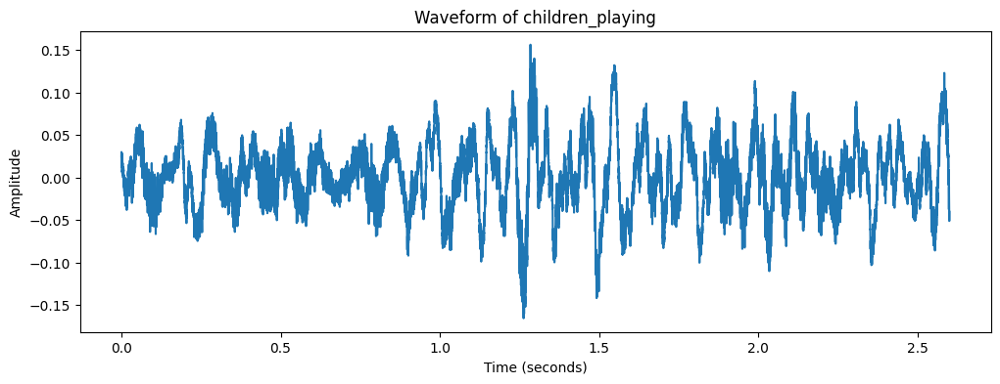

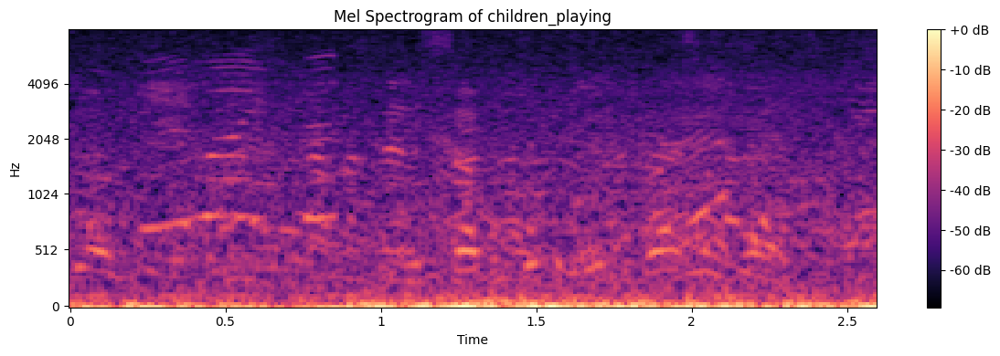

/usr/local/lib/python3.10/dist-packages/librosa/core/spectrum.py:257: UserWarning: n_fft=1024 is too large for input signal of length=896
  warnings.warn(


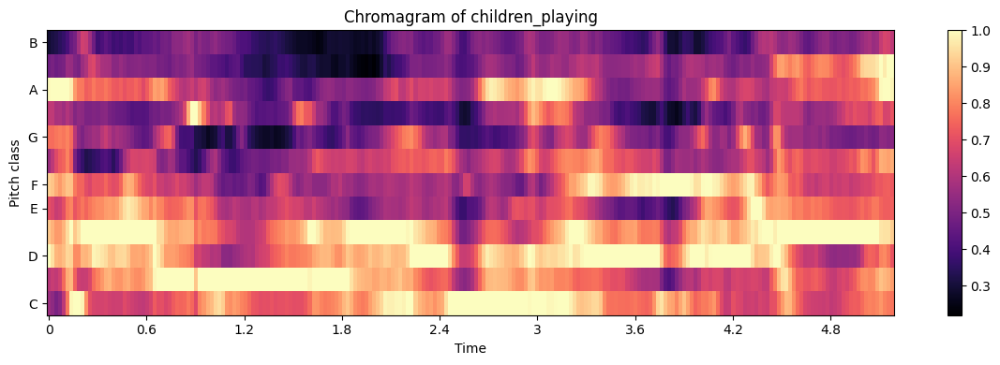

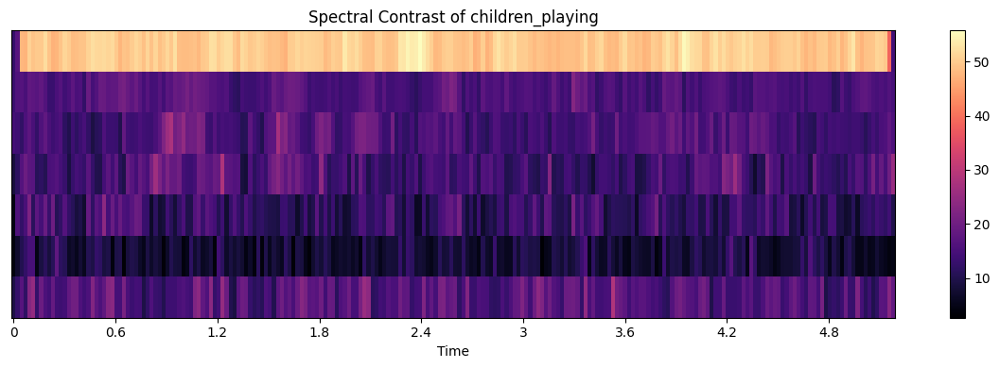

/usr/local/lib/python3.10/dist-packages/librosa/core/spectrum.py:257: UserWarning: n_fft=1024 is too large for input signal of length=896
  warnings.warn(


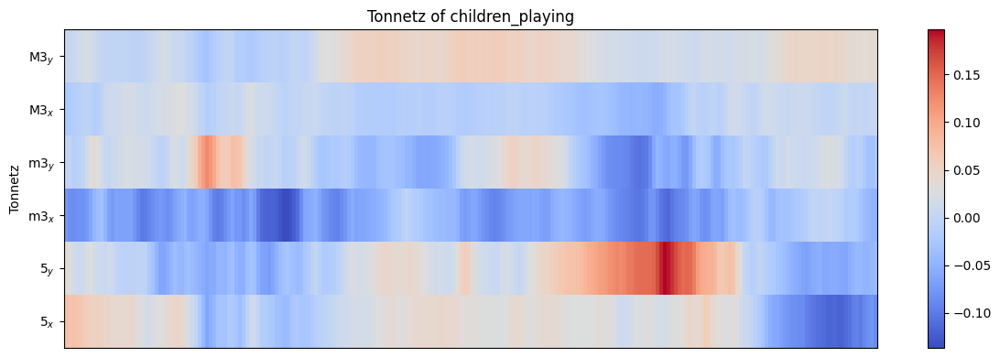

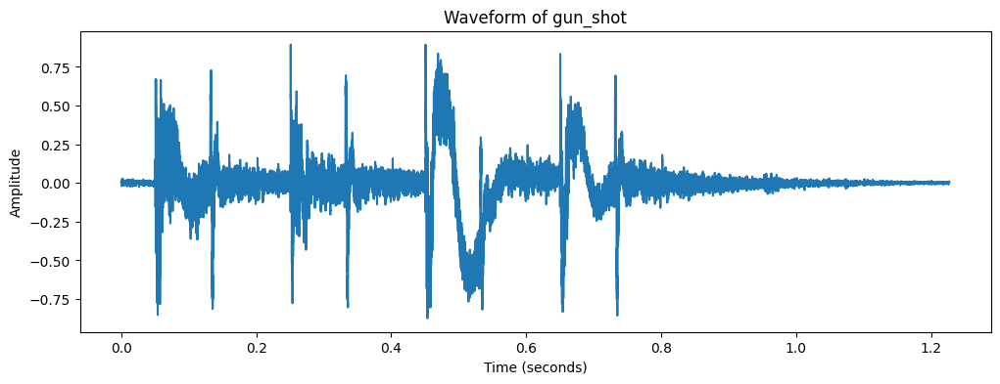

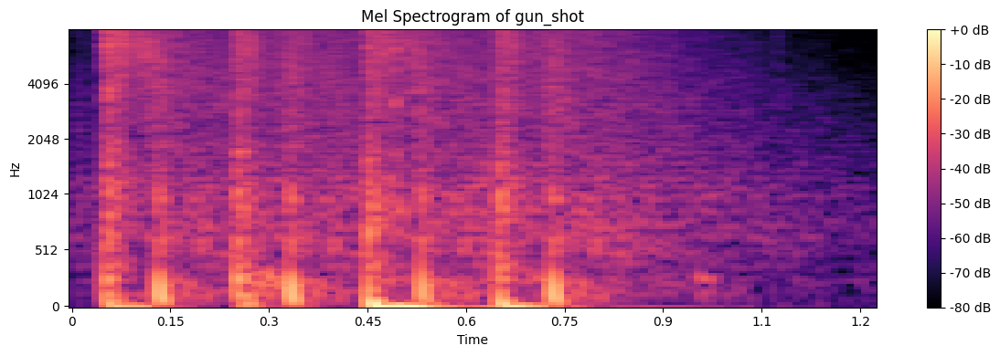

/usr/local/lib/python3.10/dist-packages/librosa/core/spectrum.py:257: UserWarning: n_fft=1024 is too large for input signal of length=846
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/librosa/core/spectrum.py:257: UserWarning: n_fft=1024 is too large for input signal of length=423
  warnings.warn(


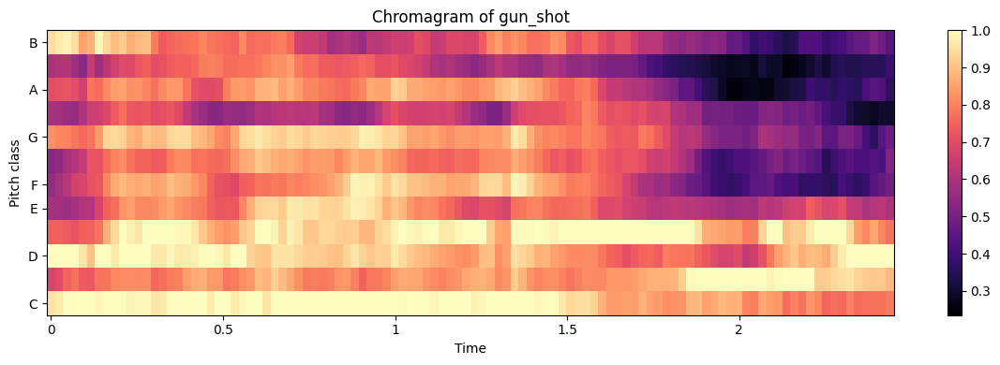

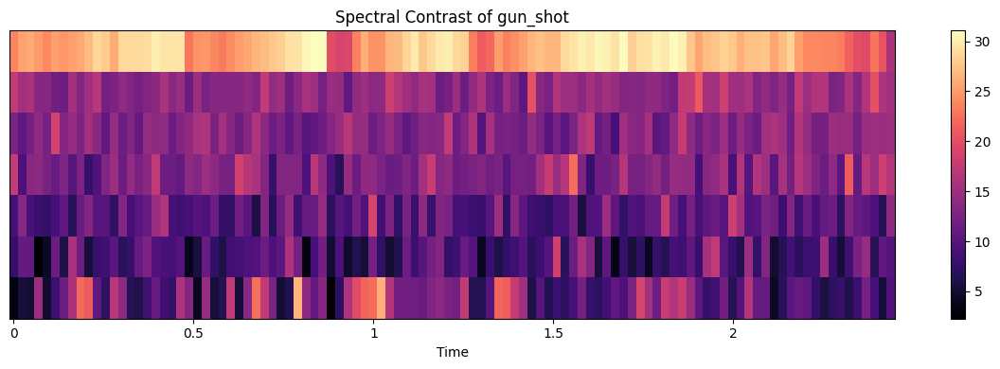

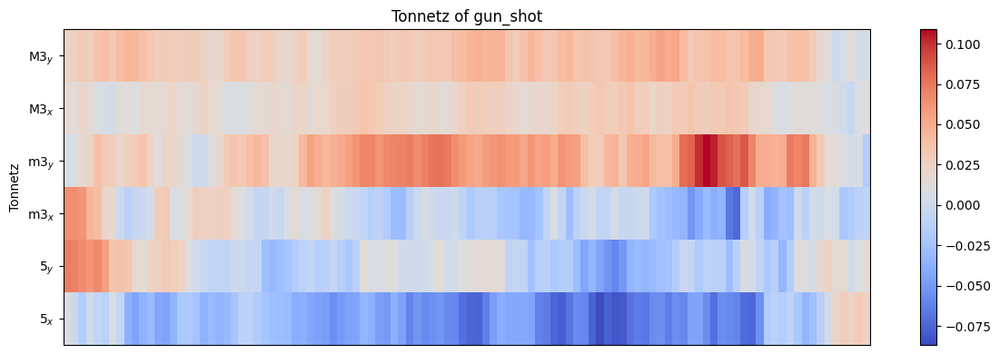

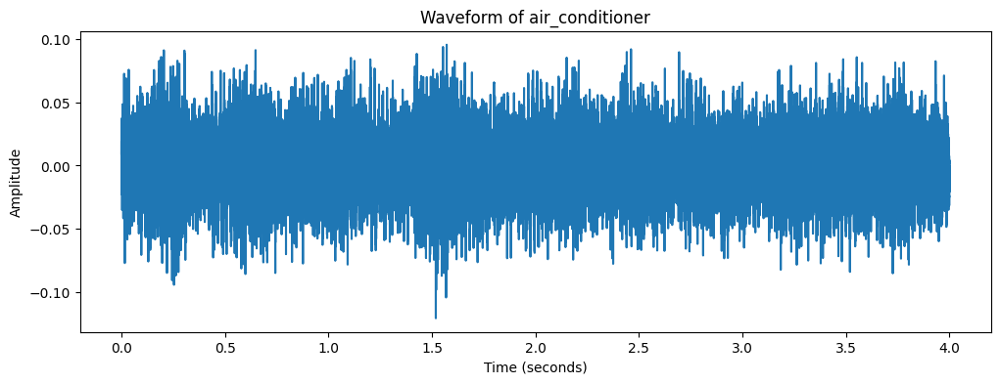

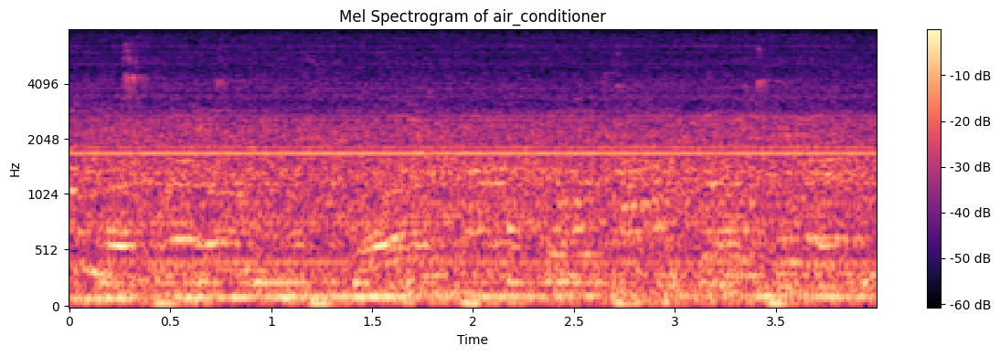

...

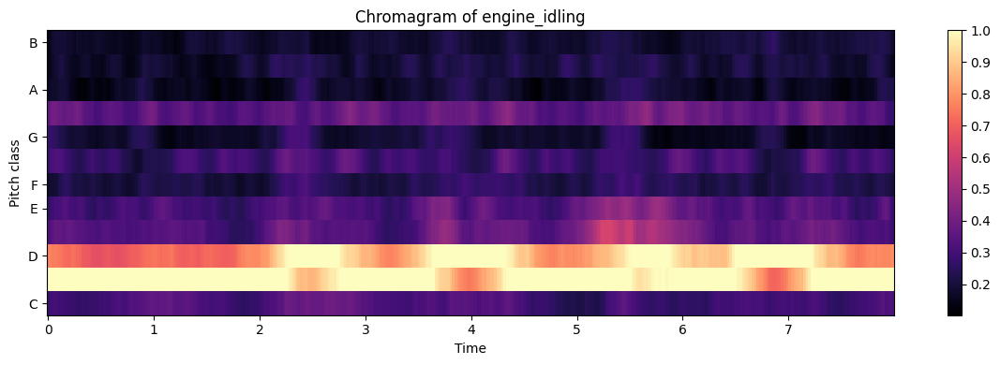

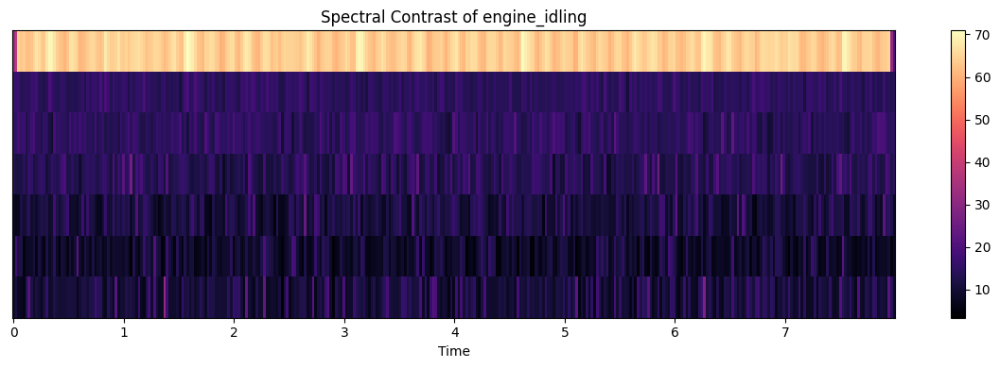

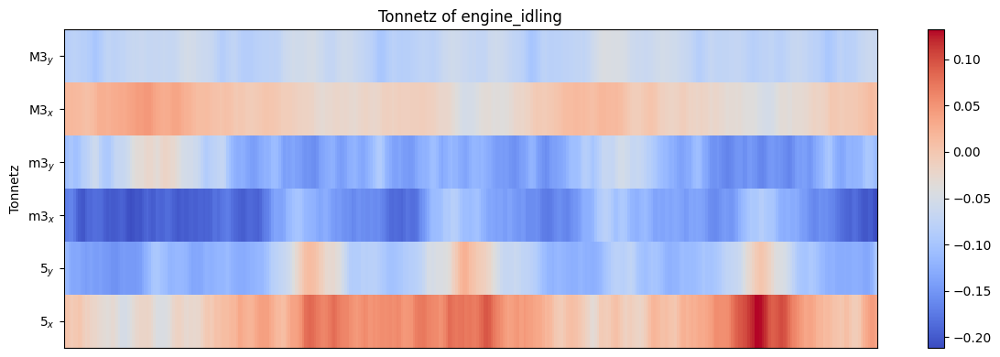

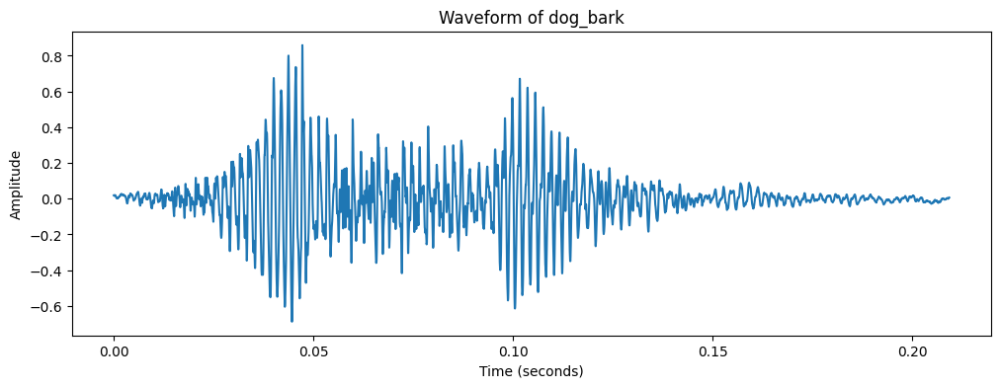

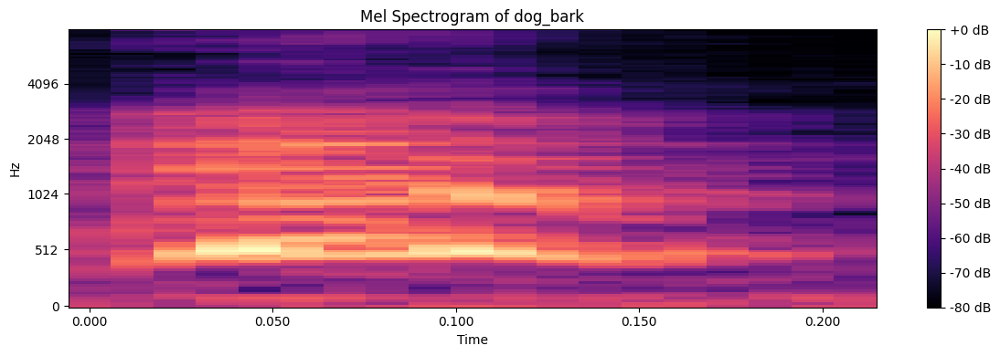

/usr/local/lib/python3.10/dist-packages/librosa/core/spectrum.py:257: UserWarning: n_fft=1024 is too large for input signal of length=577
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/librosa/core/spectrum.py:257: UserWarning: n_fft=1024 is too large for input signal of length=289
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/librosa/core/spectrum.py:257: UserWarning: n_fft=1024 is too large for input signal of length=145
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/librosa/core/spectrum.py:257: UserWarning: n_fft=1024 is too large for input signal of length=73
  warnings.warn(


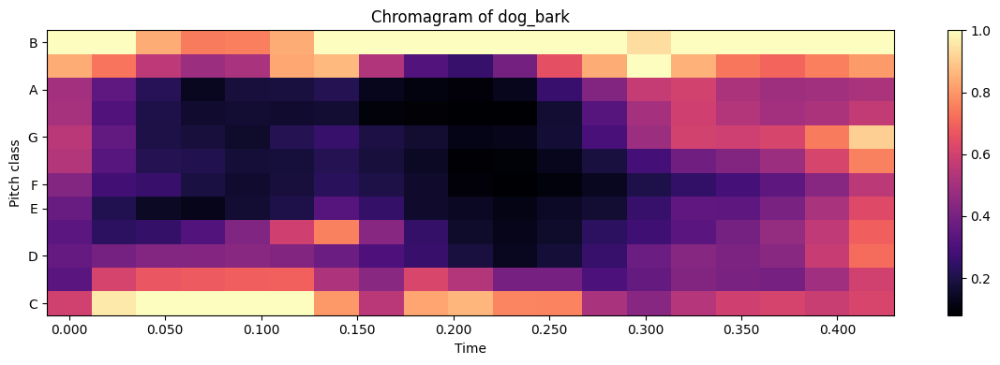

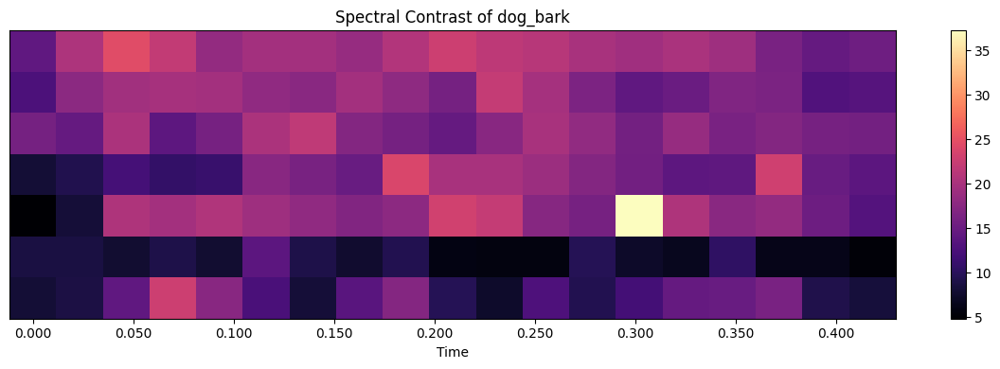

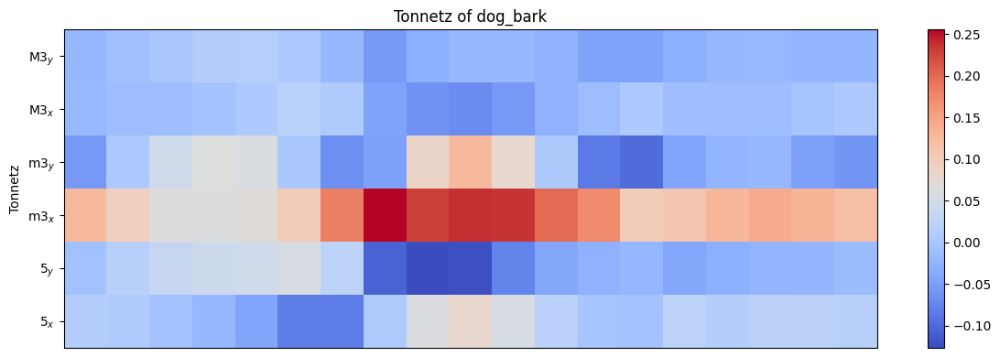

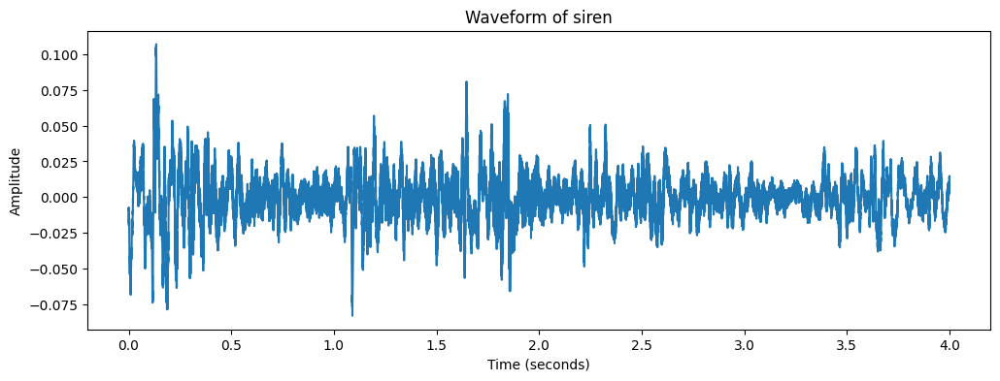

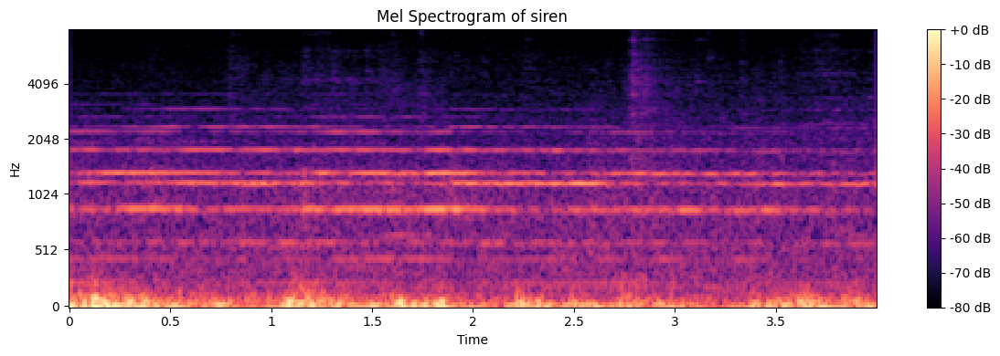

...

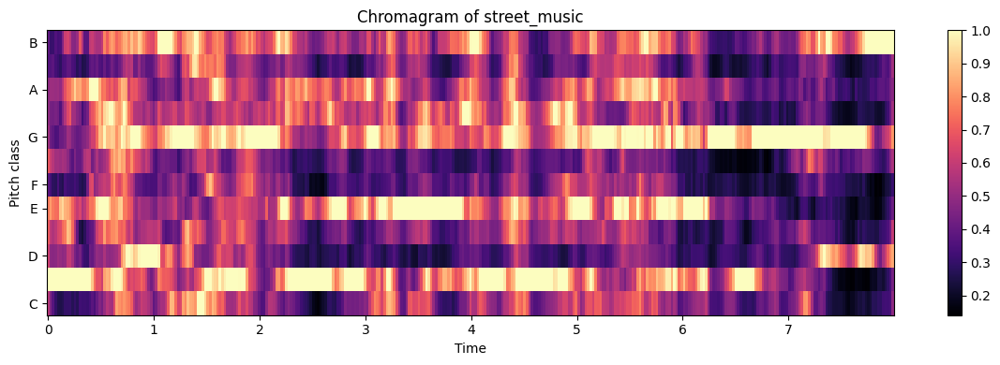

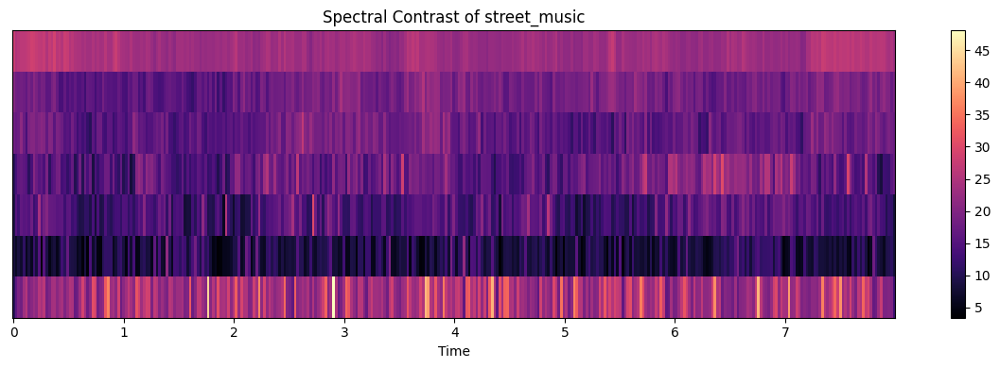

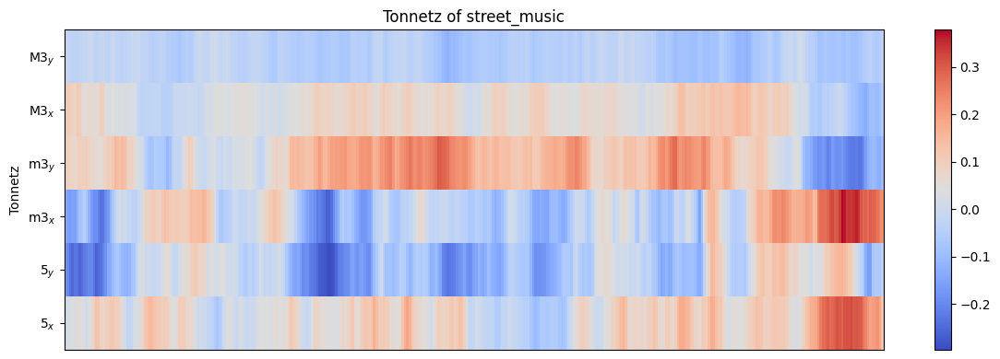

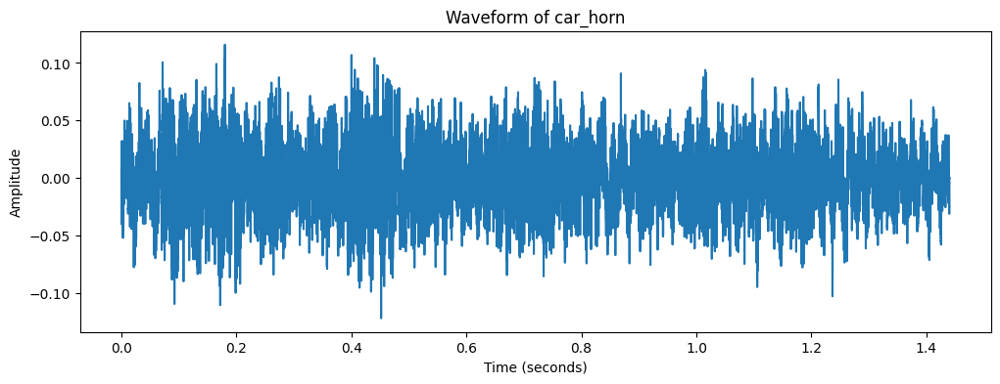

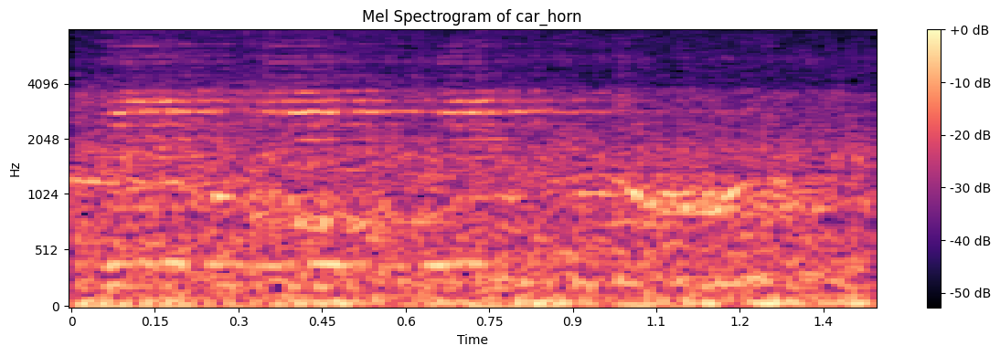

/usr/local/lib/python3.10/dist-packages/librosa/core/spectrum.py:257: UserWarning: n_fft=1024 is too large for input signal of length=993
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/librosa/core/spectrum.py:257: UserWarning: n_fft=1024 is too large for input signal of length=497
  warnings.warn(


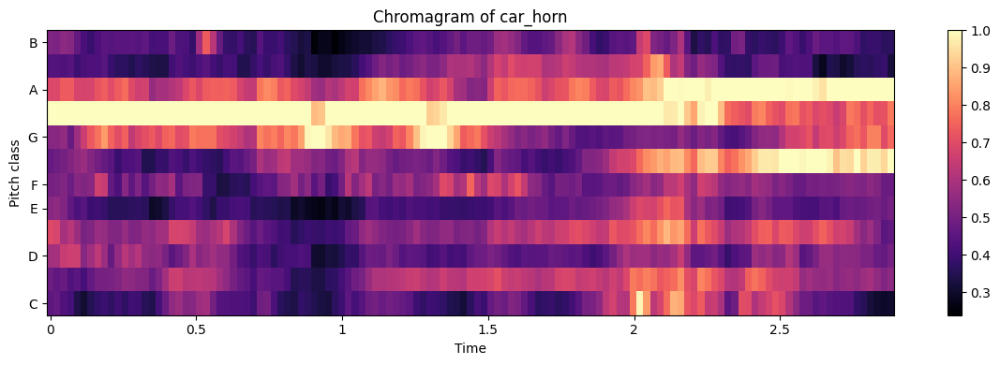

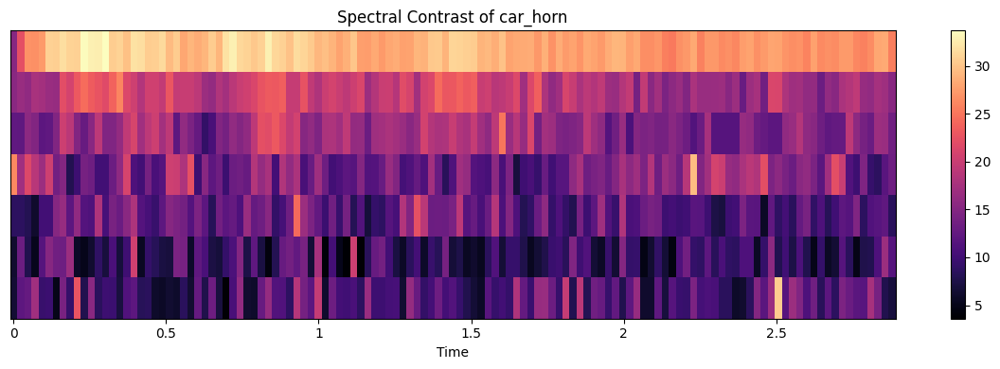

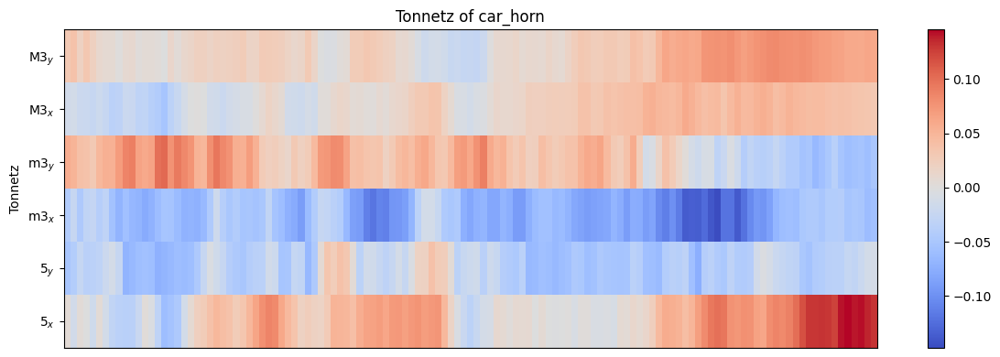

In [8]:
# Function to visualize the waveform and spectrogram for each class label
def visualize_audio_clips(dataset):
    # Initialize a dictionary to hold clip IDs for each class label
    clips_per_class = defaultdict(list)
    for clip_id in dataset.clip_ids:
        clip = dataset.clip(clip_id)
        clips_per_class[clip.class_label].append(clip_id)

    # Select a random clip ID for each class label
    selected_clip_ids = {class_label: random.choice(clip_ids) for class_label, clip_ids in clips_per_class.items()}

    # Visualize waveform and spectrogram for each selected clip
    for class_label, clip_id in selected_clip_ids.items():
        clip = dataset.clip(clip_id)
        audio, sr = clip.audio

        # Plot waveform
        plt.figure(figsize=(12, 4))
        plt.plot(np.linspace(0, len(audio) / sr, num=len(audio)), audio)
        plt.title(f'Waveform of {class_label}')
        plt.ylabel('Amplitude')
        plt.xlabel('Time (seconds)')
        plt.show()

        # Compute and plot Mel spectrogram
        S = librosa.feature.melspectrogram(y=audio, sr=sr, n_mels=128, fmax=8000)
        S_DB = librosa.power_to_db(S, ref=np.max)

        plt.figure(figsize=(12, 4))
        librosa.display.specshow(S_DB, sr=sr, x_axis='time', y_axis='mel', fmax=8000)
        plt.colorbar(format='%+2.0f dB')
        plt.title(f'Mel Spectrogram of {class_label}')
        plt.tight_layout()
        plt.show()

        # Compute and plot Chromagram
        chroma = librosa.feature.chroma_cqt(y=audio, sr=sr)
        plt.figure(figsize=(12, 4))
        librosa.display.specshow(chroma, y_axis='chroma', x_axis='time')
        plt.colorbar()
        plt.title(f'Chromagram of {class_label}')
        plt.tight_layout()
        plt.show()

        # Compute and plot Spectral Contrast
        contrast = librosa.feature.spectral_contrast(y=audio, sr=sr)
        plt.figure(figsize=(12, 4))
        librosa.display.specshow(contrast, x_axis='time')
        plt.colorbar()
        plt.title(f'Spectral Contrast of {class_label}')
        plt.tight_layout()
        plt.show()

        # Compute and plot Tonnetz
        y = librosa.effects.harmonic(audio)
        tonnetz = librosa.feature.tonnetz(y=y, sr=sr)
        plt.figure(figsize=(12, 4))
        librosa.display.specshow(tonnetz, y_axis='tonnetz')
        plt.colorbar()
        plt.title(f'Tonnetz of {class_label}')
        plt.tight_layout()
        plt.show()

        print('=' * 150)
        print('=' * 150)

# Call the function
visualize_audio_clips(dataset)

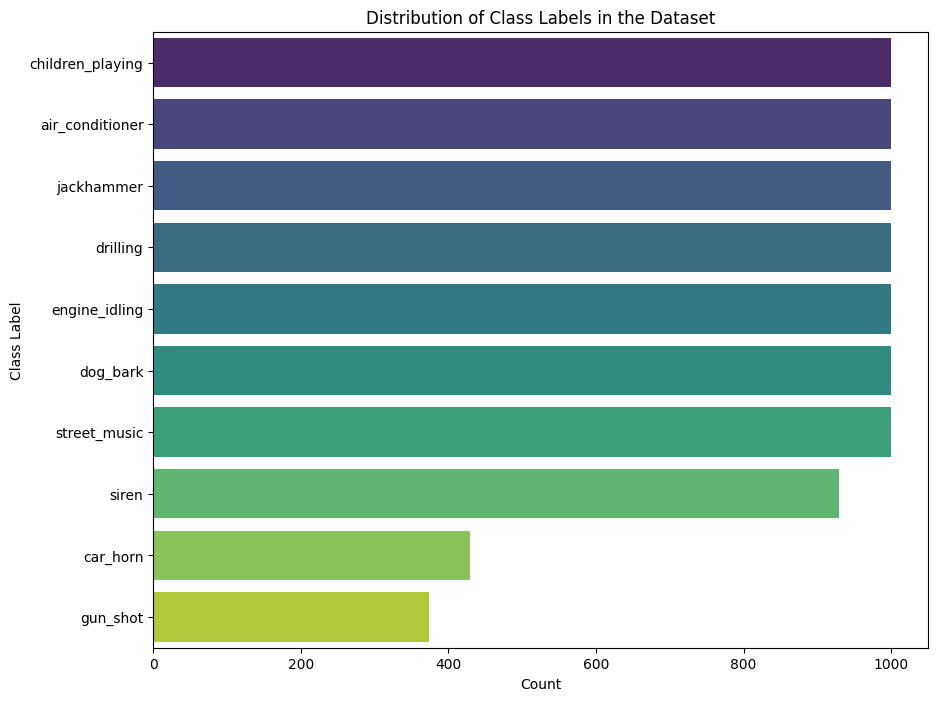

In [9]:
# Function to plot the class label distribution
def plot_class_distribution(dataset):
    # Collect all class labels
    class_labels = [dataset.clip(clip_id).class_label for clip_id in dataset.clip_ids]

    # Count the frequency of each label
    label_counts = Counter(class_labels)

    # Sorting labels and counts for better visualization
    labels, counts = zip(*sorted(label_counts.items(), key=lambda x: x[1], reverse=True))

    # Plot the distribution
    plt.figure(figsize=(10, 8))
    sns.barplot(x=list(counts), y=list(labels), hue=list(labels), palette="viridis")
    plt.title('Distribution of Class Labels in the Dataset')
    plt.xlabel('Count')
    plt.ylabel('Class Label')
    plt.show()

# Call the function
plot_class_distribution(dataset)

In [10]:
# Function to get counts of samples per class
def samples_per_class_dataframe(dataset):
    # Collect all class labels
    class_labels = [dataset.clip(clip_id).class_label for clip_id in dataset.clip_ids]

    # Count the frequency of each label
    label_counts = Counter(class_labels)

    # Create a DataFrame from the counts
    df = pd.DataFrame(label_counts.items(), columns=['Class Label', 'Count']).sort_values(by='Count', ascending=False).reset_index(drop=True)

    return df

# Call the function
df_samples_per_class = samples_per_class_dataframe(dataset)
df_samples_per_class

,Class Label,Count
0,children_playing,1000
1,air_conditioner,1000
2,jackhammer,1000
3,drilling,1000
4,engine_idling,1000
5,dog_bark,1000
6,street_music,1000
7,siren,929
8,car_horn,429
9,gun_shot,374


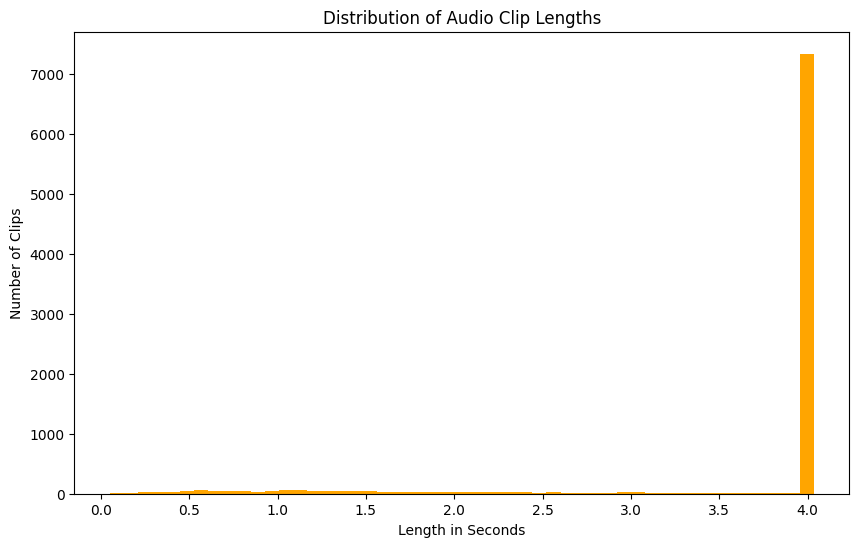

In [11]:
# Function to plot distribution of clip lengths
def plot_clip_lengths_distribution(dataset):
    clip_lengths = []
    for clip_id in dataset.clip_ids:
        clip = dataset.clip(clip_id)
        audio, sr = clip.audio
        clip_length = len(audio) / sr
        clip_lengths.append(clip_length)

    # Plotting the distribution
    plt.figure(figsize=(10, 6))
    plt.hist(clip_lengths, bins=50, color='orange')
    plt.title('Distribution of Audio Clip Lengths')
    plt.xlabel('Length in Seconds')
    plt.ylabel('Number of Clips')
    plt.show()

# Call the function
plot_clip_lengths_distribution(dataset)

In [12]:
# Function to inspect audio files
def select_audio_to_inspect_by_class(dataset):
    # Group clips by class label
    clips_per_class = defaultdict(list)
    for clip_id in dataset.clip_ids:
        clip = dataset.clip(clip_id)
        clips_per_class[clip.class_label].append(clip_id)

    # Select a random clip from each class
    selected_clip_ids = [random.choice(clips_per_class[class_label]) for class_label in clips_per_class]

    for clip_id in selected_clip_ids:
        clip = dataset.clip(clip_id)
        print(f"Playing clip ID: {clip_id}, Class Label: {clip.class_label}")

        # Display the audio player widget
        IPythondisplay(Audio(filename=clip.audio_path))

# Call the function
select_audio_to_inspect_by_class(dataset)

Playing clip ID: 193698-2-0-140, Class Label: children_playing


Playing clip ID: 25039-6-1-0, Class Label: gun_shot


Playing clip ID: 100852-0-0-26, Class Label: air_conditioner


Playing clip ID: 180937-7-0-2, Class Label: jackhammer


Playing clip ID: 78360-4-0-16, Class Label: drilling


Playing clip ID: 146186-5-0-0, Class Label: engine_idling


Playing clip ID: 128030-3-1-0, Class Label: dog_bark


Playing clip ID: 22601-8-0-45, Class Label: siren


Playing clip ID: 35548-9-0-21, Class Label: street_music


Playing clip ID: 99812-1-0-2, Class Label: car_horn


# Preprocessing the Data

## Defining Augmentations

In [13]:
class AugBasic:
    def __init__(self, fs):
        super().__init__()
        self.fs = fs
        self.fft_params = {}
        # Define FFT parameters based on different common sampling rates
        if fs == 22050:
            self.fft_params['win_len'] = [512, 1024, 2048]
            self.fft_params['hop_len'] = [128, 256, 1024]
            self.fft_params['n_fft'] = [512, 1024, 2048]
        elif fs == 16000:
            self.fft_params['win_len'] = [256, 512, 1024]
            self.fft_params['hop_len'] = [256 // 4, 512 // 4, 1024 // 4]
            self.fft_params['n_fft'] = [256, 512, 1024]
        elif fs == 8000:
            self.fft_params['win_len'] = [128, 256, 512]
            self.fft_params['hop_len'] = [32, 64, 128]
            self.fft_params['n_fft'] = [128, 256, 512]
        else:
            raise ValueError

# Room Impulse Response (RIR)
class RandomRIR(AugBasic):
    def __init__(self, fs, p=0.5):
        self.p = p
        self.fs = fs

    def rir(self, mic, n, r, rm, src):
        nn = np.arange(-n, n+1, 1).astype(np.float32)
        srcs = np.power(-1, nn)
        rms=nn+0.5-0.5*srcs
        xi=srcs*src[0]+rms*rm[0]-mic[0]
        yj=srcs*src[1]+rms*rm[1]-mic[1]
        zk=srcs*src[2]+rms*rm[2]-mic[2]
        [i, j, k]=np.meshgrid(xi, yj, zk)
        d = np.sqrt(i**2+j**2+k**2)
        t = np.round(self.fs*d/343.)+1
        [e, f, g]=np.meshgrid(nn, nn, nn)
        c = np.power(r, np.abs(e)+np.abs(f)+np.abs(g))
        e = c/d
        y = np.ones_like(d).reshape(-1).astype(np.int32)
        t = t.reshape(-1).astype(np.int32)
        e = e.reshape(-1)
        h = coo_matrix((e, (t, y))).todense()[:, 1]
        h = np.array(h).ravel()
        h = h/np.abs(h).max()
        if h.shape[0] % 2 == 0:
            h = h[:-1]
        return h

    def __call__(self, sample):
        if random.random() < self.p:
            r = 2 * np.random.rand(1) - 1
            n = 3

            x = 20 * np.random.rand(1)
            y = 20 * np.random.rand(1)
            z = 4 * np.random.rand(1)
            rm = np.array([x, y, z])

            x = rm[0] * np.random.rand(1)
            y = rm[1] * np.random.rand(1)
            z = rm[2] * np.random.rand(1)

            mic = np.array([x, y, z])
            x = rm[0] * np.random.rand(1)
            y = rm[1] * np.random.rand(1)
            z = rm[2] * np.random.rand(1)

            src = np.array([x, y, z])

            h = self.rir(mic, n, r, rm, src)
            h = torch.from_numpy(h).float()
            sample = sample[None, None, :]
            sample = F.pad(sample, (h.shape[-1]//2, h.shape[-1]//2), "reflect")
            sample = F.conv1d(sample, h[None, None, :], bias=None, stride=1, padding=0, dilation=1,
                              groups=sample.shape[1])
        return sample, h

    def __str__(self):
        return f"RandomRIR(fs={self.fs}, p={self.p})"


# Low-Pass and High-Pass Filter
class RandomLPHPFilter(AugBasic):
    def __init__(self, fs, p=0.5, fc_lp=None, fc_hp=None):
        self.p = p
        self.fs = fs
        self.fc_lp = fc_lp
        self.fc_hp = fc_hp
        self.num_taps = 15

    def __call__(self, sample):
        if random.random() < self.p:
            a = 0.25
            if random.random() < 0.5:
                fc = 0.5 + random.random() * 0.25
                filt = scipy.signal.firwin(self.num_taps, fc, window='hamming')
            else:
                fc = random.random() * 0.25
                filt = scipy.signal.firwin(self.num_taps, fc, window='hamming', pass_zero=False)
            filt = torch.from_numpy(filt).float()
            filt = filt / filt.sum()
            sample = F.pad(sample.view(1, 1, -1), (filt.shape[0]//2, filt.shape[0]//2), mode="reflect")
            sample = F.conv1d(sample, filt.view(1, 1, -1), stride=1, groups=1)
            sample = sample.view(-1)
        return sample

    def __str__(self):
        return f"RandomLPHPFilter(fs={self.fs}, p={self.p}, fc_lp={self.fc_lp}, fc_hp={self.fc_hp})"


# Time Shift
class RandomTimeShift(AugBasic):
    def __init__(self, p=0.5, max_time_shift=None):
        self.p = p
        self.max_time_shift = max_time_shift

    def __call__(self, sample):
        if random.random() < self.p:
            if self.max_time_shift is None:
                self.max_time_shift = sample.shape[-1] // 10

            int_d = 2 * random.randint(0, self.max_time_shift) - self.max_time_shift
            frac_d = np.round(100 * (random.random() - 0.5)) / 100

            if int_d > 0:
                pad = torch.zeros(int_d, dtype=sample.dtype)
                sample = torch.cat((pad, sample[:-int_d]), dim=-1)
            elif int_d < 0:
                pad = torch.zeros(-int_d, dtype=sample.dtype)
                sample = torch.cat((sample[-int_d:], pad), dim=-1)

            if frac_d != 0:
                n = sample.shape[-1]

                dw = 2 * np.pi / n
                w = torch.fft.fftfreq(n, d=1/n).float() * 2 * np.pi
                phi = frac_d * w

                sample_fft = torch.fft.fft(sample)
                sample_shifted = torch.fft.ifft(sample_fft * torch.exp(-1j * phi)).real

                sample = sample_shifted[:n]

        return sample

    def __str__(self):
        return f"RandomTimeShift(p={self.p}, max_time_shift={self.max_time_shift})"


# Time Masking
class RandomTimeMasking(AugBasic):
    def __init__(self, p=0.5, n_mask=None):
        self.n_mask = n_mask
        self.p = p

    def __call__(self, sample):
        if self.n_mask is None:
            self.n_mask = int(0.05 * sample.shape[-1])
        if random.random() < self.p:
            max_start = sample.size(-1) - self.n_mask
            idx_rand = random.randint(0, max_start)
            sample[idx_rand:idx_rand + self.n_mask] = torch.randn(self.n_mask) * 1e-6
        return sample

    def __str__(self):
        return f"RandomTimeMasking(p={self.p}, n_mask={self.n_mask})"


# Mu-Law Compression
class RandomMuLawCompression(AugBasic):
    def __init__(self, p=0.5, n_channels=256):
        self.n_channels = n_channels
        self.p = p

    def __call__(self, sample):
        if random.random() < self.p:
            e = torchaudio.functional.mu_law_encoding(sample, self.n_channels)
            sample = torchaudio.functional.mu_law_decoding(e, self.n_channels)
        return sample

    def __str__(self):
        return f"RandomMuLawCompression(p={self.p}, n_channels={self.n_channels})"


# Amplitude Scaling
class RandomAmp(AugBasic):
    def __init__(self, low, high, p=0.5):
        self.low = low
        self.high = high
        self.p = p

    def __call__(self, sample):
        if random.random() < self.p:
            amp = torch.FloatTensor(1).uniform_(self.low, self.high)
            sample.mul_(amp)
        return sample

    def __str__(self):
        return f"RandomAmp(low={self.low}, high={self.high}, p={self.p})"


# Flipping
class RandomFlip(AugBasic):
    def __init__(self, p=0.5):
        self.p = p

    def __call__(self, sample):
        if random.random() < self.p:
            sample.data = torch.flip(sample.data, dims=[-1, ])
        return sample

    def __str__(self):
        return f"RandomFlip(p={self.p})"


# Adding 180 Phase
class RandomAdd180Phase(AugBasic):
    def __init__(self, p=0.5):
        self.p = p

    def __call__(self, sample):
        if random.random() < self.p:
            sample.mul_(-1)
        return sample

    def __str__(self):
        return f"RandomAdd180Phase(p={self.p})"


# Additive White Gaussian Noise
class RandomAdditiveWhiteGN(AugBasic):
    def __init__(self, p=0.5, snr_db=30):
        self.snr_db = snr_db
        self.min_snr_db = 30
        self.p = p

    def __call__(self, sample):
        if random.random() < self.p:
            s = torch.sqrt(torch.mean(sample ** 2))
            snr_db = self.min_snr_db + torch.rand(1) * (self.snr_db - self.min_snr_db)
            sgm = s * 10 ** (-snr_db / 20.)
            w = torch.randn_like(sample).mul_(sgm)
            sample.add_(w)
        return sample

    def __str__(self):
        return f"RandomAdditiveWhiteGN(p={self.p}, snr_db={self.snr_db})"


# Additive Uniform Noise
class RandomAdditiveUN(AugBasic):
    def __init__(self, snr_db=35, p=0.5):
        self.snr_db = snr_db
        self.min_snr_db = 30
        self.p = p

    def __call__(self, sample):
        if random.random() < self.p:
            s = torch.sqrt(torch.mean(sample ** 2))
            snr_db = self.min_snr_db + torch.rand(1) * (self.snr_db - self.min_snr_db)
            sgm = s * 10 ** (-snr_db / 20.) * np.sqrt(3)
            w = torch.rand_like(sample).mul_(2 * sgm).add_(-sgm)
            sample.add_(w)
        return sample

    def __str__(self):
        return f"RandomAdditiveUN(snr_db={self.snr_db}, p={self.p})"


# Additive Pink Gaussian Noise
class RandomAdditivePinkGN(AugBasic):
    def __init__(self, snr_db=35, p=0.5):
        self.snr_db = snr_db
        self.min_snr_db = 30
        self.p = p

    def __call__(self, sample):
        if random.random() < self.p:
            s = torch.sqrt(torch.mean(sample ** 2))
            n = sample.shape[-1]
            w = torch.randn(n)
            nn = n // 2 + 1
            k = torch.arange(1, nn + 1, 1).float()
            W = torch.fft.fft(w)
            W = W[:nn] / k.sqrt()
            W = torch.cat((W, W.flip(dims=(-1,))[1:-1].conj()), dim=-1)
            w = torch.fft.ifft(W).real
            w.add_(w.mean()).div_(w.std())
            if w.size(-1) > sample.size(-1):
                w = w[:sample.size(-1)]
            elif w.size(-1) < sample.size(-1):
                padding_size = sample.size(-1) - w.size(-1)
                w = F.pad(w, (0, padding_size), 'constant', 0)
            snr_db = self.min_snr_db + torch.rand(1) * (self.snr_db - self.min_snr_db)
            sgm = s * 10 ** (-snr_db / 20.)
            sample = sample.add(w.mul_(sgm))
        return sample

    def __str__(self):
        return f"RandomAdditivePinkGN(snr_db={self.snr_db}, p={self.p})"


# Additive Violet Gaussian Noise
class RandomAdditiveVioletGN(AugBasic):
    def __init__(self, p=0.5, snr_db=35):
        self.snr_db = snr_db
        self.min_snr_db = 30
        self.p = p

    def __call__(self, sample):
        if random.random() < self.p:
            s = torch.sqrt(torch.mean(sample ** 2))
            n = sample.shape[-1]
            w = torch.randn(n)
            nn = n // 2 + 1
            k = torch.arange(1, nn + 1, 1).float()
            W = torch.fft.fft(w)
            W = W[:nn] * k
            W = torch.cat((W, W.flip(dims=(-1,))[1:-1].conj()), dim=-1)
            w = torch.fft.ifft(W).real
            w.add_(w.mean()).div_(w.std())
            if w.size(-1) > sample.size(-1):
                w = w[:sample.size(-1)]
            elif w.size(-1) < sample.size(-1):
                padding_size = sample.size(-1) - w.size(-1)
                w = F.pad(w, (0, padding_size), 'constant', 0)
            snr_db = self.min_snr_db + torch.rand(1) * (self.snr_db - self.min_snr_db)
            sgm = s * 10 ** (-snr_db / 20.)
            sample = sample.add(w.mul_(sgm))
        return sample

    def __str__(self):
        return f"RandomAdditiveVioletGN(p={self.p}, snr_db={self.snr_db})"


# Additive Red Gaussian Noise
class RandomAdditiveRedGN(AugBasic):
    def __init__(self, p=0.5, snr_db=35):
        self.snr_db = snr_db
        self.min_snr_db = 30
        self.p = p

    def __call__(self, sample):
        if random.random() < self.p:
            s = torch.sqrt(torch.mean(sample ** 2))
            n = sample.shape[-1]
            w = torch.randn(n)
            nn = n // 2 + 1
            k = torch.arange(1, nn + 1, 1).float()
            W = torch.fft.fft(w)
            W = W[:nn] / k
            W = torch.cat((W, W.flip(dims=(-1,))[1:-1].conj()), dim=-1)
            w = torch.fft.ifft(W).real
            w.add_(w.mean()).div_(w.std())
            if w.size(-1) > sample.size(-1):
                w = w[:sample.size(-1)]
            elif w.size(-1) < sample.size(-1):
                padding_size = sample.size(-1) - w.size(-1)
                w = F.pad(w, (0, padding_size), 'constant', 0)
            snr_db = self.min_snr_db + torch.rand(1) * (self.snr_db - self.min_snr_db)
            sgm = s * 10 ** (-snr_db / 20.)
            sample = sample.add(w.mul_(sgm))
        return sample

    def __str__(self):
        return f"RandomAdditiveRedGN(p={self.p}, snr_db={self.snr_db})"


# Additive Blue Gaussian Noise
class RandomAdditiveBlueGN(AugBasic):
    def __init__(self, p=0.5, snr_db=35):
        self.snr_db = snr_db
        self.min_snr_db = 30
        self.p = p

    def __call__(self, sample):
        if random.random() < self.p:
            s = torch.sqrt(torch.mean(sample ** 2))
            n = sample.shape[-1]
            w = torch.randn(n)
            nn = n // 2 + 1
            k = torch.arange(1, nn + 1, 1).float()
            W = torch.fft.fft(w)
            W = W[:nn] * k.sqrt()
            W = torch.cat((W, W.flip(dims=(-1,))[1:-1].conj()), dim=-1)
            w = torch.fft.ifft(W).real
            w.add_(w.mean()).div_(w.std())
            if w.size(-1) > sample.size(-1):
                w = w[:sample.size(-1)]
            elif w.size(-1) < sample.size(-1):
                padding_size = sample.size(-1) - w.size(-1)
                w = F.pad(w, (0, padding_size), 'constant', 0)
            snr_db = self.min_snr_db + torch.rand(1) * (self.snr_db - self.min_snr_db)
            sgm = s * 10 ** (-snr_db / 20.)
            sample = sample.add(w.mul_(sgm))
        return sample

    def __str__(self):
        return f"RandomAdditiveBlueGN(p={self.p}, snr_db={self.snr_db})"


# Frequency Shift
class RandomFreqShift(AugBasic):
    def __init__(self, sgm, fs, p=0.5):
        super().__init__(fs=fs)
        self.sgm = sgm
        self.p = p

    def __call__(self, sample):
        if random.random() < self.p:
            win_idx = random.randint(0, len(self.fft_params['win_len']) - 1)
            df = self.fs / self.fft_params['win_len'][win_idx]
            f_shift = torch.randn(1).mul_(self.sgm * df)
            t = torch.arange(0, self.fft_params['win_len'][win_idx], 1).float()
            w = torch.real(torch.exp(-1j * 2 * np.pi * t * f_shift))
            X = torch.stft(sample,
                           win_length=self.fft_params['win_len'][win_idx],
                           hop_length=self.fft_params['hop_len'][win_idx],
                           n_fft=self.fft_params['n_fft'][win_idx],
                           window=w,
                           return_complex=True)
            sample = torch.istft(X,
                                 win_length=self.fft_params['win_len'][win_idx],
                                 hop_length=self.fft_params['hop_len'][win_idx],
                                 n_fft=self.fft_params['n_fft'][win_idx])

        return sample

    def __str__(self):
        return f"RandomFreqShift(sgm={self.sgm}, fs={self.fs}, p={self.p})"


# Add Sine Wave
class RandomAddSine(AugBasic):
    def __init__(self, fs, snr_db=35, max_freq=50, p=0.5):
        self.snr_db = snr_db
        self.max_freq = max_freq
        self.min_snr_db = 30
        self.p = p
        self.fs = fs

    def __call__(self, sample):
        n = torch.arange(0, sample.shape[-1], 1)
        f = self.max_freq * torch.rand(1) + 3 * torch.randn(1)
        if random.random() < self.p:
            snr_db = self.min_snr_db + torch.rand(1) * (self.snr_db - self.min_snr_db)
            t = n * 1. / self.fs
            s = (sample ** 2).mean().sqrt()
            sgm = s * np.sqrt(2) * 10 ** (-snr_db / 20.)
            b = sgm * torch.sin(2 * np.pi * f * t + torch.rand(1) * np.pi)
            sample.add_(b)

        return sample

    def __str__(self):
        return f"RandomAddSine(fs={self.fs}, snr_db={self.snr_db}, max_freq={self.max_freq}, p={self.p})"


# Amplitude Segment Scaling
class RandomAmpSegment(AugBasic):
    def __init__(self, low, high, max_len=None, p=0.5):
        self.low = low
        self.high = high
        self.max_len = max_len
        self.p = p

    def __call__(self, sample):
        if random.random() < self.p:
            if self.max_len is None:
                self.max_len = sample.shape[-1] // 10
            idx = random.randint(0, self.max_len)
            amp = torch.FloatTensor(1).uniform_(self.low, self.high)
            sample[idx: idx + self.max_len].mul_(amp)
        return sample

    def __str__(self):
        return f"RandomAmpSegment(low={self.low}, high={self.high}, max_len={self.max_len}, p={self.p})"


# Phase Noise
class RandomPhNoise(AugBasic):
    def __init__(self, fs, sgm=0.01, p=0.5):
        super().__init__(fs=fs)
        self.sgm = sgm
        self.p = p

    def __call__(self, sample):
        if random.random() < self.p:
            win_idx = random.randint(0, len(self.fft_params['win_len']) - 1)
            sgm_noise = self.sgm + 0.01 * torch.rand(1)
            X = torch.stft(sample,
                           win_length=self.fft_params['win_len'][win_idx],
                           hop_length=self.fft_params['hop_len'][win_idx],
                           n_fft=self.fft_params['n_fft'][win_idx],
                           return_complex=True)
            w = sgm_noise * torch.rand_like(X)
            phn = torch.exp(1j * w)
            X.mul_(phn)
            sample = torch.istft(X,
                                 win_length=self.fft_params['win_len'][win_idx],
                                 hop_length=self.fft_params['hop_len'][win_idx],
                                 n_fft=self.fft_params['n_fft'][win_idx])
        return sample

    def __str__(self):
        return f"RandomPhNoise(fs={self.fs}, sgm={self.sgm}, p={self.p})"


# Cyclic Shift
class RandomCyclicShift(AugBasic):
    def __init__(self, max_time_shift=None, p=0.5):
        self.max_time_shift = max_time_shift
        self.p = p

    def __call__(self, sample):
        if random.random() < self.p:
            if self.max_time_shift is None:
                self.max_time_shift = sample.shape[-1]
            int_d = random.randint(0, self.max_time_shift - 1)
            if int_d > 0:
                sample = torch.cat((sample[-int_d:], sample[:-int_d]), dim=-1)
            else:
                pass
        return sample

    def __str__(self):
        return f"RandomCyclicShift(max_time_shift={self.max_time_shift}, p={self.p})"

In [14]:
# Audio Augmentation Manager Class
class AudioAugs():
    def __init__(self, k_augs, fs, p=0.5, snr_db=30):
        self.noise_vec = ['awgn', 'abgn', 'apgn', 'argn', 'avgn', 'aun', 'phn', 'sine']
        augs = {}
        for aug in k_augs:
            if aug == 'amp':
                augs['amp'] = RandomAmp(p=p, low=0.5, high=1.3)
            elif aug == 'flip':
                augs['flip'] = RandomFlip(p)
            elif aug == 'neg':
                augs['neg'] = RandomAdd180Phase(p)
            elif aug == 'awgn':
                augs['awgn'] = RandomAdditiveWhiteGN(p=p, snr_db=snr_db)
            elif aug == 'abgn':
                augs['abgn'] = RandomAdditiveBlueGN(p=p, snr_db=snr_db)
            elif aug == 'argn':
                augs['argn'] = RandomAdditiveRedGN(p=p, snr_db=snr_db)
            elif aug == 'avgn':
                augs['avgn'] = RandomAdditiveVioletGN(p=p, snr_db=snr_db)
            elif aug == 'apgn':
                augs['apgn'] = RandomAdditivePinkGN(p=p, snr_db=snr_db)
            elif aug == 'mulaw':
                augs['mulaw'] = RandomMuLawCompression(p=p, n_channels=256)
            elif aug == 'tmask':
                augs['tmask'] = RandomTimeMasking(p=p, n_mask=int(0.1 * fs))
            elif aug == 'tshift':
                augs['tshift'] = RandomTimeShift(p=p, max_time_shift=int(0.1 * fs))
            elif aug == 'sine':
                augs['sine'] = RandomAddSine(p=p, fs=fs)
            elif aug == 'cycshift':
                augs['cycshift'] = RandomCyclicShift(p=p, max_time_shift=None)
            elif aug == 'ampsegment':
                augs['ampsegment'] = RandomAmpSegment(p=p, low=0.5, high=1.3, max_len=int(0.1 * fs))
            elif aug == 'aun':
                augs['aun'] = RandomAdditiveUN(p=p, snr_db=snr_db)
            elif aug == 'phn':
                augs['phn'] = RandomPhNoise(p=p, fs=fs, sgm=0.01)
            elif aug == 'fshift':
                augs['fshift'] = RandomFreqShift(fs=fs, sgm=1, p=p)
            else:
                raise ValueError("{} not supported".format(aug))
        self.augs = augs
        self.augs_signal = [a for a in augs if a not in self.noise_vec]
        self.augs_noise = [a for a in augs if a in self.noise_vec]

    def __call__(self, sample, **kwargs):
        applied_transforms = []
        augs = self.augs_signal.copy()
        augs_noise = self.augs_noise
        random.shuffle(augs)
        if len(augs_noise) > 0:
            i = random.randint(0, len(augs_noise) - 1)
            augs.append(augs_noise[i])
        for aug_name in augs:
            aug = self.augs[aug_name]
            sample_before = sample.clone()
            sample = aug(sample)
            if not torch.equal(sample_before, sample):
                applied_transforms.append(str(aug))
        return sample, applied_transforms

## Creating Dataset Class

In [15]:
# Dataset Class for UrbanSound8k dataset
class UrbanSound8KDataset(Dataset):
    def __init__(
            self,
            dataset,
            fold,
            mode='train',
            target_sample_rate=22050,
            segment_length=22050 * 4,
            transforms=None
    ):
        self.dataset = dataset
        self.fold = fold
        self.mode = mode
        self.target_sample_rate = target_sample_rate
        self.segment_length = segment_length
        self.transforms = transforms

        # Filter clips based on fold and mode
        if mode == 'train':
            self.clips = [clip for clip in dataset.load_clips().values() if clip.fold != fold]
        else:  # mode == 'test'
            self.clips = [clip for clip in dataset.load_clips().values() if clip.fold == fold]

    def __len__(self):
        return len(self.clips)

    def __getitem__(self, idx):
        clip = self.clips[idx]
        audio, sr = clip.audio
        applied_transforms = []

        # Resample audio if necessary
        if sr != self.target_sample_rate:
            audio = librosa.resample(audio, orig_sr=sr, target_sr=self.target_sample_rate)

        # Convert to PyTorch tensor
        audio_tensor = torch.tensor(audio).float()

        # Normalize the audio
        audio_tensor = self.rms_normalize(audio_tensor)

        # Apply transformations before padding
        if self.transforms:
            audio_tensor, transformations = self.transforms(audio_tensor)
            applied_transforms.extend(transformations)

        # Ensure audio segment is of the fixed length
        audio_tensor = self.ensure_fixed_length(audio_tensor)

        # Unsqueeze to add channel dimension
        audio_tensor = audio_tensor.unsqueeze(0)
        label = clip.class_id
        label_str = clip.class_label

        return audio_tensor, label, label_str, applied_transforms

    @staticmethod
    def peak_normalize(audio_tensor):
            max_val = torch.max(torch.abs(audio_tensor))
            if max_val > 0:
                audio_tensor = audio_tensor / max_val
            return audio_tensor

    @staticmethod
    def rms_normalize(audio_tensor):
        rms = torch.sqrt(torch.mean(audio_tensor**2))
        target_rms = 0.1
        if rms > 0:
            normalization_factor = target_rms / rms
            audio_tensor = audio_tensor * normalization_factor
        return audio_tensor

    def ensure_fixed_length(self, audio_tensor):
        if audio_tensor.size(0) < self.segment_length:
            padding_size = self.segment_length - audio_tensor.size(0)
            audio_tensor = torch.nn.functional.pad(audio_tensor, (0, padding_size), 'constant', 0)
        elif audio_tensor.size(0) > self.segment_length:
            audio_tensor = audio_tensor[:self.segment_length]
        return audio_tensor

In [16]:
# Create the Datasets
audio_augs = AudioAugs(
    ['amp', 'awgn', 'phn'],
    fs=22050,
    p=0.5,
    snr_db=30
)
fold = 1
train_dataset = UrbanSound8KDataset(dataset, fold=fold, mode='train', transforms=audio_augs)
test_dataset = UrbanSound8KDataset(dataset, fold=fold, mode='test')

In [17]:
# Check the length of the datasets
print(f"Total clips in train dataset: {len(train_dataset)}")
print(f"Total clips in test dataset: {len(test_dataset)}")

Total clips in train dataset: 7859
Total clips in test dataset: 873


In [18]:
# Inspect a single sample
audio_tensor, label, label_str, applied_transforms = train_dataset[0]
print(f"Audio Tensor Shape: {audio_tensor.shape}")
print(f"Label: {label}")
print(f"Label String: {label_str}")
print(f"Applied Transforms: {applied_transforms}")

Audio Tensor Shape: torch.Size([1, 88200])
Label: 7
Label String: jackhammer
Applied Transforms: []


In [19]:
# Inspect a few samples
for i in range(5):
    random_idx = random.randint(0, len(train_dataset) - 1)
    audio_tensor, label, label_str, applied_transforms = train_dataset[random_idx]
    print(f"Sample {i}: Audio Tensor Shape = {audio_tensor.shape}, Label = {label}, Label String = {label_str}, Applied Transforms = {applied_transforms}")

Sample 0: Audio Tensor Shape = torch.Size([1, 88200]), Label = 2, Label String = children_playing, Applied Transforms = ['RandomAmp(low=0.5, high=1.3, p=0.5)']
Sample 1: Audio Tensor Shape = torch.Size([1, 88200]), Label = 8, Label String = siren, Applied Transforms = ['RandomAdditiveWhiteGN(p=0.5, snr_db=30)']
Sample 2: Audio Tensor Shape = torch.Size([1, 88200]), Label = 6, Label String = gun_shot, Applied Transforms = ['RandomAmp(low=0.5, high=1.3, p=0.5)', 'RandomPhNoise(fs=22050, sgm=0.01, p=0.5)']
Sample 3: Audio Tensor Shape = torch.Size([1, 88200]), Label = 0, Label String = air_conditioner, Applied Transforms = ['RandomAmp(low=0.5, high=1.3, p=0.5)', 'RandomAdditiveWhiteGN(p=0.5, snr_db=30)']
Sample 4: Audio Tensor Shape = torch.Size([1, 88200]), Label = 4, Label String = drilling, Applied Transforms = []


## Creating DataLoaders

In [20]:
# Set the DataLoader constants
BATCH_SIZE = 32
NUM_WORKERS = 4
PIN_MEMORY = True

In [21]:
# Custom collate function
def custom_collate_fn(batch):
    batch_audio_tensors, batch_labels, batch_label_strs, batch_transforms = zip(*batch)

    # Collate the audio tensors, labels, and label strings using the default collate function
    batch_audio_tensors = default_collate(batch_audio_tensors)
    batch_labels = default_collate(batch_labels)
    batch_label_strs = default_collate(batch_label_strs)

    # Handle the variable-length lists of applied_transforms
    batch_transforms = [list(transforms) for transforms in batch_transforms]

    return batch_audio_tensors, batch_labels, batch_label_strs, batch_transforms

In [22]:
# Collect class labels for all samples in the training dataset
all_labels = [train_dataset.clips[idx].class_id for idx in range(len(train_dataset))]

# Count the number of occurrences of each class in the dataset
class_counts = np.bincount(all_labels)

# Determine the total number of unique classes in the dataset
num_classes = len(class_counts)

# Calculate smoothed class weights
alpha = 0.2
epsilon = 1e-7
smoothed_weights = (1 - alpha) / (np.array(class_counts) + epsilon) + alpha / num_classes

# Assign a sample weight for each sample in the dataset based on its class
sample_weights = smoothed_weights[all_labels]

# Convert to a PyTorch Tensor
sample_weights = torch.from_numpy(sample_weights).double()

# Create a WeightedRandomSampler
sampler = WeightedRandomSampler(
    weights=sample_weights,
    num_samples=len(sample_weights),
    replacement=True
)

In [23]:
# Create the DataLoaders
train_dataloader = DataLoader(
    train_dataset,
    batch_size=BATCH_SIZE,
    shuffle=False,
    num_workers=NUM_WORKERS,
    pin_memory=PIN_MEMORY,
    collate_fn=custom_collate_fn,
    sampler=sampler
)

test_dataloader = DataLoader(
    test_dataset,
    batch_size=BATCH_SIZE,
    shuffle=False,
    num_workers=NUM_WORKERS,
    pin_memory=PIN_MEMORY,
    collate_fn=custom_collate_fn
)

In [24]:
# Check label distributions in the batches
for i, (inputs, labels, _, _) in enumerate(train_dataloader):
    print(labels)
    if i > 5: break

tensor([3, 9, 9, 1, 9, 5, 1, 2, 5, 5, 7, 7, 5, 0, 1, 4, 5, 0, 8, 9, 5, 7, 4, 5,
        7, 8, 3, 5, 8, 3, 0, 9])
tensor([1, 7, 7, 6, 0, 2, 9, 7, 2, 2, 6, 8, 0, 7, 7, 3, 1, 0, 7, 7, 3, 7, 3, 4,
        3, 0, 8, 8, 2, 7, 6, 3])
tensor([7, 5, 7, 1, 0, 5, 1, 7, 5, 2, 2, 5, 5, 9, 5, 0, 1, 4, 3, 3, 2, 9, 3, 3,
        1, 8, 5, 5, 2, 3, 3, 1])
tensor([2, 2, 6, 4, 6, 8, 8, 9, 9, 3, 1, 7, 4, 2, 0, 1, 2, 5, 5, 4, 3, 3, 3, 1,
        9, 4, 3, 0, 4, 7, 8, 7])
tensor([2, 8, 3, 5, 1, 8, 7, 4, 4, 9, 2, 2, 0, 2, 7, 9, 4, 9, 0, 0, 5, 5, 2, 8,
        7, 9, 8, 8, 0, 7, 5, 7])
tensor([4, 5, 6, 9, 9, 8, 8, 3, 8, 4, 0, 5, 6, 3, 5, 3, 9, 2, 5, 9, 7, 5, 4, 2,
        5, 8, 0, 9, 7, 4, 0, 0])
tensor([8, 6, 1, 8, 7, 5, 3, 9, 6, 9, 3, 2, 8, 0, 8, 3, 3, 3, 8, 0, 3, 5, 2, 2,
        5, 1, 8, 0, 5, 2, 0, 4])


In [25]:
# Fetch a batch from the DataLoader
batch_audio_tensors, batch_labels, batch_label_strs, batch_applied_transforms = next(iter(train_dataloader))

# Inspect the batched data
print(f"Batch Audio Tensors Shape: {batch_audio_tensors.shape}")
print(f"Batch Labels Shape: {batch_labels.shape}")
print(f"First Label String in Batch: {batch_label_strs[0]}")
print(f"Applied Transforms for First Sample in Batch: {batch_applied_transforms[0]}")

Batch Audio Tensors Shape: torch.Size([32, 1, 88200])
Batch Labels Shape: torch.Size([32])
First Label String in Batch: drilling
Applied Transforms for First Sample in Batch: ['RandomAmp(low=0.5, high=1.3, p=0.5)']


In [26]:
# Fetch a batch from the DataLoader
batch_audio_tensors, batch_labels, batch_label_strs, batch_applied_transforms = next(iter(train_dataloader))

# Select the first audio sample from the batch
sample_audio_tensor = batch_audio_tensors[0]

# Print applied transformations for the selected sample
print(f"Applied Transforms for the First Sample: {batch_applied_transforms[0]}")

# Convert the tensor to a NumPy array
sample_audio_np = sample_audio_tensor.squeeze().cpu().numpy()

# Play the audio
Audio(sample_audio_np, rate=train_dataset.target_sample_rate)

Applied Transforms for the First Sample: []


In [27]:
# Randomly select 5 unique indices from the batch
random_indices = np.random.choice(len(batch_audio_tensors), size=5, replace=False)

# Iterate over the selected indices to process and play audio
for i, idx in enumerate(random_indices, start=1):
    # Select audio sample and its applied transforms
    sample_audio_tensor = batch_audio_tensors[idx]
    applied_transforms = batch_applied_transforms[idx]

    # Convert the tensor to a NumPy array
    sample_audio_np = sample_audio_tensor.squeeze().cpu().numpy()

    # Print the applied transformations for the sample
    print(f"Sample {i}: Applied Transforms: {applied_transforms}")

    # Play the audio
    IPythondisplay(Audio(sample_audio_np, rate=train_dataset.target_sample_rate))

Sample 1: Applied Transforms: []


Sample 2: Applied Transforms: []


Sample 3: Applied Transforms: ['RandomAdditiveWhiteGN(p=0.5, snr_db=30)']


Sample 4: Applied Transforms: ['RandomAdditiveWhiteGN(p=0.5, snr_db=30)']


Sample 5: Applied Transforms: ['RandomAmp(low=0.5, high=1.3, p=0.5)', 'RandomAdditiveWhiteGN(p=0.5, snr_db=30)']


# Building the Model

## Model Components

In [28]:
# 1-Dimensional Residual Block
class ResBlock1dTF(nn.Module):
    def __init__(self, dim, dilation=1, kernel_size=3):
        super(ResBlock1dTF, self).__init__()
        # Temporal feature extraction block with dilation
        self.block_t = nn.Sequential(
            nn.ReflectionPad1d(dilation * (kernel_size // 2)),
            nn.Conv1d(dim, dim, kernel_size=kernel_size, stride=1, bias=False, dilation=dilation, groups=dim),
            nn.BatchNorm1d(dim),
            nn.LeakyReLU(0.2, True)
        )
        # Feature transformation block
        self.block_f = nn.Sequential(
            nn.Conv1d(dim, dim, 1, 1, bias=False),
            nn.BatchNorm1d(dim),
            nn.LeakyReLU(0.2, True)
        )
        # Shortcut connection for identity mapping
        self.shortcut = nn.Conv1d(dim, dim, 1, 1)

    def forward(self, x):
        # Combines the output of the feature and transformation blocks with the shortcut
        x = self.shortcut(x) + self.block_f(x) + self.block_t(x)
        return x


# Anti-Aliasing Downsampling Layer
class AADownsample(nn.Module):
    def __init__(self, filt_size=3, stride=2, channels=None):
        super(AADownsample, self).__init__()
        self.filt_size = filt_size
        self.stride = stride
        self.channels = channels

        # Custom filter for anti-aliasing
        ha = torch.arange(1, filt_size // 2 + 1 + 1, 1)
        a = torch.cat((ha, ha.flip(dims=[-1])[1:])).float()
        a = a / a.sum()
        filt = a[None, :]
        self.register_buffer('filt', filt[None, :, :].repeat((self.channels, 1, 1)))

    def forward(self, x):
        # Applies padding and the anti-aliasing filter
        x_pad = F.pad(x, (self.filt_size // 2, self.filt_size // 2), "reflect")
        x = F.conv1d(x_pad, self.filt, stride=self.stride, padding=0, groups=x.shape[1])
        return x


# Downsampling Block
class Down(nn.Module):
    def __init__(self, channels, d=2, k=3):
        super(Down, self).__init__()
        # Configures downsampling with anti-aliasing
        kk = d + 1
        self.down = nn.Sequential(
            nn.ReflectionPad1d(kk // 2),
            nn.Conv1d(channels, channels * 2, kernel_size=kk, stride=1, bias=False),
            nn.BatchNorm1d(channels * 2),
            nn.LeakyReLU(0.2, True),
            AADownsample(channels=channels * 2, stride=d, filt_size=k)
        )

    def forward(self, x):
        # Applies the downsampling sequence
        x = self.down(x)
        return x


# Transformer Aggregator
class TAggregate(nn.Module):
    def __init__(self, clip_length, embed_dim=64, n_layers=6, nhead=6, n_classes=None, dim_feedforward=512):
        super(TAggregate, self).__init__()
        self.clip_length = clip_length
        self.num_tokens = 1
        drop_rate = 0.1

        # Transformer encoder setup
        enc_layer = nn.TransformerEncoderLayer(
            d_model=embed_dim,
            nhead=nhead,
            activation="gelu",
            dim_feedforward=dim_feedforward,
            dropout=drop_rate
        )
        self.transformer_enc = nn.TransformerEncoder(enc_layer, num_layers=n_layers, norm=nn.LayerNorm(embed_dim))

        # Positional embeddings and classification
        self.cls_token = nn.Parameter(torch.zeros(1, 1, embed_dim))
        self.pos_embed = nn.Parameter(torch.zeros(1, self.clip_length + self.num_tokens, embed_dim))
        self.fc = nn.Linear(embed_dim, n_classes)

        # Weight initialization
        self.apply(self._init_weights)

    def _init_weights(self, m):
        if isinstance(m, nn.Linear):
            with torch.no_grad():
                if isinstance(m, nn.Linear) and m.bias is not None:
                    nn.init.constant_(m.bias, 0)
                    # nn.init.constant_(m.weight, 1)
        elif isinstance(m, nn.LayerNorm):
            nn.init.constant_(m.bias, 0)
            nn.init.constant_(m.weight, 1.0)
        elif isinstance(m, nn.Parameter):
            with torch.no_grad():
                m.weight.data.normal_(0.0, 0.02)
                # nn.init.orthogonal_(m.weight)

    def forward(self, x):
        # Integrates transformer encoding with positional and class tokens
        x = x.permute(0, 2, 1).contiguous()
        cls_tokens = self.cls_token.expand(x.shape[0], -1, -1)
        x = torch.cat((cls_tokens, x), dim=1)
        x += self.pos_embed
        x.transpose_(1, 0)
        o = self.transformer_enc(x)
        pred = self.fc(o[0])
        return pred

## SoundNet Model

In [29]:
# SoundNet Class
class SoundNet(nn.Module):
    def __init__(self, nf=32, clip_length=None, embed_dim=128, n_layers=4, nhead=8, factors=[4, 4, 4, 4], n_classes=10, dim_feedforward=512):
        super(SoundNet, self).__init__()
        self.nf = nf
        self.clip_length = clip_length
        self.embed_dim = embed_dim
        self.n_layers = n_layers
        self.nhead = nhead
        self.factors = factors
        self.n_classes = n_classes
        self.dim_feedforward = dim_feedforward

        model = [
            nn.ReflectionPad1d(3),
            nn.Conv1d(1, nf, kernel_size=7, stride=1, bias=False),
            nn.BatchNorm1d(nf),
            nn.LeakyReLU(0.2, True),
        ]
        self.start = nn.Sequential(*model)
        model = []
        for i, f in enumerate(factors):
            model += [Down(channels=nf, d=f, k=f*2+1)]
            nf *= 2
            if i % 2 == 0:
                model += [ResBlock1dTF(dim=nf, dilation=1, kernel_size=15)]
        self.down = nn.Sequential(*model)

        factors = [2, 2]
        model = []
        for _, f in enumerate(factors):
            for i in range(1):
                for j in range(3):
                    model += [ResBlock1dTF(dim=nf, dilation=3 ** j, kernel_size=15)]
            model += [Down(channels=nf, d=f, k=f*2+1)]
            nf *= 2
        self.down2 = nn.Sequential(*model)
        self.project = nn.Conv1d(nf, embed_dim, 1)
        self.clip_length = clip_length
        self.tf = TAggregate(embed_dim=embed_dim, clip_length=clip_length, n_layers=n_layers, nhead=nhead, n_classes=n_classes, dim_feedforward=dim_feedforward)
        self.apply(self._init_weights)

    def _init_weights(self, m):
        if isinstance(m, nn.Conv1d):
            with torch.no_grad():
                m.weight.data.normal_(0.0, 0.02)
                if m.bias is not None:
                    nn.init.constant_(m.bias, 0)

        elif isinstance(m, nn.BatchNorm1d):
            nn.init.constant_(m.bias, 0)
            nn.init.constant_(m.weight, 1.0)

    def forward(self, x):
        x = self.start(x)
        x = self.down(x)
        x = self.down2(x)
        x = self.project(x)
        pred = self.tf(x)
        return pred

# Model Training Loop

## Early Stopping Class Utility

In [30]:
# Early Stopping Class
class EarlyStopping:
    def __init__(self, patience=7, min_delta=0.001):
        self.patience = patience
        self.min_delta = min_delta
        self.counter = 0
        self.best_loss = None
        self.early_stop = False

    def __call__(self, val_loss):
        # Update the best loss or increase the counter based on validation loss
        if self.best_loss is None:
            self.best_loss = val_loss
        elif val_loss < self.best_loss - self.min_delta:
            self.best_loss = val_loss
            self.counter = 0
        else:
            self.counter += 1
            if self.counter >= self.patience:
                self.early_stop = True

## Best Model Across Folds Method

In [31]:
# Trainer class for SoundNet model with cross-validation
class SoundNetTrainer:
    def __init__(
            self,
            model_class,
            dataset,
            batch_size=32,
            num_workers=4,
            pin_memory=True,
            epochs=10,
            learning_rate=1e-3,
            weight_decay=1e-4,
            clip_norm=1.0,
            nf=32,
            clip_length=None,
            embed_dim=128,
            n_layers=6,
            nhead=8,
            factors=None,
            n_classes=10,
            dim_feedforward=512,
            inspect_logits=False
    ):
        # Store model-specific parameters
        self.nf = nf
        self.clip_length = clip_length
        self.embed_dim = embed_dim
        self.n_layers = n_layers
        self.nhead = nhead
        self.factors = factors
        self.n_classes = n_classes
        self.dim_feedforward = dim_feedforward
        self.inspect_logits = inspect_logits

        self.model_class = model_class
        self.dataset = dataset
        self.batch_size = batch_size
        self.num_workers = num_workers
        self.pin_memory = pin_memory
        self.epochs = epochs
        self.learning_rate = learning_rate
        self.weight_decay = weight_decay
        self.clip_norm = clip_norm
        self.device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
        self.loss_fn = nn.CrossEntropyLoss()
        self.scheduler = None

        self.train_losses = []
        self.train_accuracies = []
        self.val_losses = []
        self.val_accuracies = []

        self.all_train_losses = []
        self.all_train_accuracies = []
        self.all_val_losses = []
        self.all_val_accuracies = []

        self.best_model_path = None

    # Generates a weighted random sampler for handling class imbalance in the subset
    def get_sampler(self, subset_indices):
        # Extracts class labels for the given subset indices
        subset_labels = [self.dataset.clips[idx].class_id for idx in subset_indices]

        # Counts occurrences of each class to calculate weights
        class_counts = np.bincount(subset_labels, minlength=len(np.unique([clip.class_id for clip in self.dataset.clips])))

        # Smooth class weights to avoid extreme values
        alpha = 0.1
        epsilon = 1e-6
        num_classes = len(class_counts)
        smoothed_weights = (1 - alpha) / (np.array(class_counts) + epsilon) + alpha / num_classes

        # Assigns weights to each sample in the subset
        sample_weights = smoothed_weights[subset_labels]
        sample_weights = torch.from_numpy(sample_weights).double()

        # Returns a weighted sampler for the subset
        weighted_sampler = WeightedRandomSampler(weights=sample_weights, num_samples=len(sample_weights), replacement=True)

        return weighted_sampler

    # Trains the model using the DataLoader and optimizer for a single epoch
    def train(self, model, train_loader, optimizer):
        model.train()
        total_loss, total_accuracy = 0, 0

        # Iterates over training data
        for i, (inputs, labels, _, _) in enumerate(tqdm(train_loader, desc="Training")):
            inputs, labels = inputs.to(self.device), labels.to(self.device)
            optimizer.zero_grad()
            outputs = model(inputs)

            # Conditional logit inspection for the first batch
            if i == 0 and self.inspect_logits == True:
                print("Inspecting logits for one batch:")
                print(outputs)

                # Print the corresponding labels to compare
                print("Corresponding labels:")
                print(labels)

            loss = self.loss_fn(outputs, labels)
            loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), self.clip_norm)
            optimizer.step()
            total_loss += loss.item()
            total_accuracy += self.compute_accuracy(outputs, labels)

        # Returns average loss and accuracy for the epoch
        average_train_loss, average_train_accuracy = total_loss / len(train_loader), total_accuracy / len(train_loader)

        return average_train_loss, average_train_accuracy

    # Evaluates the model using the given DataLoader
    def evaluate(self, model, val_loader):
        model.eval()
        total_loss, total_accuracy = 0, 0

        with torch.no_grad():
            for inputs, labels, _, _ in tqdm(val_loader, desc="Validation"):
                inputs, labels = inputs.to(self.device), labels.to(self.device)
                outputs = model(inputs)
                loss = self.loss_fn(outputs, labels)
                total_loss += loss.item()
                total_accuracy += self.compute_accuracy(outputs, labels)

        # Returns average loss and accuracy for the validation set
        average_val_loss, average_val_accuracy = total_loss / len(val_loader), total_accuracy / len(val_loader)

        return average_val_loss, average_val_accuracy

    # Computes accuracy given model outputs and true labels
    def compute_accuracy(self, outputs, labels):
        _, preds = torch.max(outputs, 1)

        accuracy = torch.sum(preds == labels.data).double() / labels.size(0)
        return accuracy.item()

    # Conducts training and validation for a single fold in cross-validation
    def train_fold(self, train_indices, val_indices, fold_number):
        # Initialize model for each fold
        model = self.model_class(
            nf=self.nf,
            clip_length=self.clip_length,
            embed_dim=self.embed_dim,
            n_layers=self.n_layers,
            nhead=self.nhead,
            factors=self.factors,
            n_classes=self.n_classes,
            dim_feedforward=self.dim_feedforward
        ).to(self.device)

        # Creates samplers for balanced training and subset validation
        train_sampler = self.get_sampler(train_indices)
        val_sampler = SubsetRandomSampler(val_indices)

        # Prepares DataLoaders for training and validation subsets
        train_loader = DataLoader(self.dataset, batch_size=self.batch_size, sampler=train_sampler, num_workers=self.num_workers, pin_memory=self.pin_memory, collate_fn=custom_collate_fn)
        val_loader = DataLoader(self.dataset, batch_size=self.batch_size, sampler=val_sampler, num_workers=self.num_workers, pin_memory=self.pin_memory, collate_fn=custom_collate_fn)

        # Configures optimizer and early stopping mechanism
        optimizer = torch.optim.AdamW(model.parameters(), lr=self.learning_rate, weight_decay=self.weight_decay)
        self.scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=2, threshold=0.01, verbose=True)
        early_stopping = EarlyStopping(patience=7, min_delta=0.001)

        # Setup for best model saving
        best_val_loss = float('inf')
        best_model_path = f'best_model_fold_{fold_number}.pth'

        # Iterates over epochs for training and validation
        for epoch in range(self.epochs):
            train_loss, train_acc = self.train(model, train_loader, optimizer)
            val_loss, val_acc = self.evaluate(model, val_loader)

            # Save metrics
            self.train_losses.append(train_loss)
            self.train_accuracies.append(train_acc)
            self.val_losses.append(val_loss)
            self.val_accuracies.append(val_acc)

            # Update learning rate based on validation loss
            self.scheduler.step(val_loss)

            # Update best model and save
            if val_loss < best_val_loss:
                print(f"New best model found at epoch {epoch+1} with validation loss: {val_loss:.4f}")
                best_val_loss = val_loss
                torch.save(model.state_dict(), best_model_path)

            # Print metrics
            print(f"Epoch {epoch+1}, Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.4f}, Val Loss: {val_loss:.4f}, Val Acc: {val_acc:.4f}")
            if early_stopping(val_loss):
                print("Early stopping.")
                break

    # Executes cross-validation across the dataset
    def cross_validate(self, n_folds=10):
        # Determines the size and indices for each fold
        dataset_size = len(self.dataset)
        indices = torch.randperm(dataset_size).tolist()
        fold_size = dataset_size // n_folds

        best_val_loss_global = float('inf')

        # Conducts training and validation for each fold
        for fold in range(n_folds):
            print(f"\nFold {fold+1}/{n_folds}")
            val_indices = indices[fold * fold_size:(fold + 1) * fold_size]
            train_indices = indices[:fold * fold_size] + indices[(fold + 1) * fold_size:]

            # Reset metrics for each fold
            self.train_losses = []
            self.train_accuracies = []
            self.val_losses = []
            self.val_accuracies = []

            self.train_fold(train_indices, val_indices, fold + 1)

            fold_avg_val_loss = np.mean(self.val_losses)
            if fold_avg_val_loss < best_val_loss_global:
                best_val_loss_global = fold_avg_val_loss
                self.best_model_path = f'best_model_fold_{fold+1}.pth'

            # Aggregate metrics for each fold
            self.all_train_losses.append(self.train_losses)
            self.all_train_accuracies.append(self.train_accuracies)
            self.all_val_losses.append(self.val_losses)
            self.all_val_accuracies.append(self.val_accuracies)

        # Compute and print the average and standard deviation of the metrics across folds
        avg_val_loss = np.mean(self.all_val_losses)
        std_val_loss = np.std(self.all_val_losses)

        avg_val_acc = np.mean(self.all_val_accuracies)
        std_val_acc = np.std(self.all_val_accuracies)

        print(f"Average Validation Loss: {avg_val_loss}, Std: {std_val_loss}")
        print(f"Average Validation Accuracy: {avg_val_acc}, Std: {std_val_acc}")

        print(f"Best overall validation loss: {best_val_loss_global}")
        print(f"Best model saved at: {self.best_model_path}")

        return self.best_model_path

## Best Model Averaging Method

In [32]:
# Trainer class for SoundNet model with cross-validation
class SoundNetTrainer:
    def __init__(
            self,
            model_class,
            dataset,
            batch_size=32,
            num_workers=4,
            pin_memory=True,
            epochs=10,
            learning_rate=1e-3,
            weight_decay=1e-4,
            clip_norm=1.0,
            nf=32,
            clip_length=None,
            embed_dim=128,
            n_layers=6,
            nhead=8,
            factors=None,
            n_classes=10,
            dim_feedforward=512,
            inspect_logits=False
    ):
        # Store model-specific parameters
        self.nf = nf
        self.clip_length = clip_length
        self.embed_dim = embed_dim
        self.n_layers = n_layers
        self.nhead = nhead
        self.factors = factors
        self.n_classes = n_classes
        self.dim_feedforward = dim_feedforward
        self.inspect_logits = inspect_logits

        self.model_class = model_class
        self.dataset = dataset
        self.batch_size = batch_size
        self.num_workers = num_workers
        self.pin_memory = pin_memory
        self.epochs = epochs
        self.learning_rate = learning_rate
        self.weight_decay = weight_decay
        self.clip_norm = clip_norm
        self.device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
        self.loss_fn = nn.CrossEntropyLoss()
        self.scheduler = None

        self.train_losses = []
        self.train_accuracies = []
        self.val_losses = []
        self.val_accuracies = []

        self.all_train_losses = []
        self.all_train_accuracies = []
        self.all_val_losses = []
        self.all_val_accuracies = []

        self.fold_performances = []
        self.best_model_path = None

    # Generates a weighted random sampler for handling class imbalance in the subset
    def get_sampler(self, subset_indices):
        # Extracts class labels for the given subset indices
        subset_labels = [self.dataset.clips[idx].class_id for idx in subset_indices]

        # Counts occurrences of each class to calculate weights
        class_counts = np.bincount(subset_labels, minlength=len(np.unique([clip.class_id for clip in self.dataset.clips])))

        # Smooth class weights to avoid extreme values
        alpha = 0.1
        epsilon = 1e-6
        num_classes = len(class_counts)
        smoothed_weights = (1 - alpha) / (np.array(class_counts) + epsilon) + alpha / num_classes

        # Assigns weights to each sample in the subset
        sample_weights = smoothed_weights[subset_labels]
        sample_weights = torch.from_numpy(sample_weights).double()

        # Returns a weighted sampler for the subset
        weighted_sampler = WeightedRandomSampler(weights=sample_weights, num_samples=len(sample_weights), replacement=True)

        return weighted_sampler

    # Trains the model using the DataLoader and optimizer for a single epoch
    def train(self, model, train_loader, optimizer):
        model.train()
        total_loss, total_accuracy = 0, 0

        # Iterates over training data
        for i, (inputs, labels, _, _) in enumerate(tqdm(train_loader, desc="Training")):
            inputs, labels = inputs.to(self.device), labels.to(self.device)
            optimizer.zero_grad()
            outputs = model(inputs)

            # Conditional logit inspection for the first batch
            if i == 0 and self.inspect_logits == True:
                print("Inspecting logits for one batch:")
                print(outputs)
                # Print the corresponding labels to compare
                print("Corresponding labels:")
                print(labels)

            loss = self.loss_fn(outputs, labels)
            loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), self.clip_norm)
            optimizer.step()
            total_loss += loss.item()
            total_accuracy += self.compute_accuracy(outputs, labels)

        # Returns average loss and accuracy for the epoch
        average_train_loss, average_train_accuracy = total_loss / len(train_loader), total_accuracy / len(train_loader)

        return average_train_loss, average_train_accuracy

    # Evaluates the model using the given DataLoader
    def evaluate(self, model, val_loader):
        model.eval()
        total_loss, total_accuracy = 0, 0

        with torch.no_grad():
            for inputs, labels, _, _ in tqdm(val_loader, desc="Validation"):
                inputs, labels = inputs.to(self.device), labels.to(self.device)
                outputs = model(inputs)
                loss = self.loss_fn(outputs, labels)
                total_loss += loss.item()
                total_accuracy += self.compute_accuracy(outputs, labels)

        # Returns average loss and accuracy for the validation set
        average_val_loss, average_val_accuracy = total_loss / len(val_loader), total_accuracy / len(val_loader)

        return average_val_loss, average_val_accuracy

    # Computes accuracy given model outputs and true labels
    def compute_accuracy(self, outputs, labels):
        _, preds = torch.max(outputs, 1)

        accuracy = torch.sum(preds == labels.data).double() / labels.size(0)
        return accuracy.item()

    # Conducts training and validation for a single fold in cross-validation
    def train_fold(self, train_indices, val_indices, fold_number):
        # Initialize model for each fold
        model = self.model_class(
            nf=self.nf,
            clip_length=self.clip_length,
            embed_dim=self.embed_dim,
            n_layers=self.n_layers,
            nhead=self.nhead,
            factors=self.factors,
            n_classes=self.n_classes,
            dim_feedforward=self.dim_feedforward
        ).to(self.device)

        # Creates samplers for balanced training and subset validation
        train_sampler = self.get_sampler(train_indices)
        val_sampler = SubsetRandomSampler(val_indices)

        # Prepares DataLoaders for training and validation subsets
        train_loader = DataLoader(self.dataset, batch_size=self.batch_size, sampler=train_sampler, num_workers=self.num_workers, pin_memory=self.pin_memory, collate_fn=custom_collate_fn)
        val_loader = DataLoader(self.dataset, batch_size=self.batch_size, sampler=val_sampler, num_workers=self.num_workers, pin_memory=self.pin_memory, collate_fn=custom_collate_fn)

        # Configures optimizer and early stopping mechanism
        optimizer = torch.optim.AdamW(model.parameters(), lr=self.learning_rate, weight_decay=self.weight_decay)
        self.scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.1, patience=2, threshold=0.01, verbose=True)
        early_stopping = EarlyStopping(patience=7, min_delta=0.001)

        # Setup for best model saving
        best_val_loss = float('inf')
        best_model_path = f'best_model_fold_{fold_number}.pth'

        # Iterates over epochs for training and validation
        for epoch in range(self.epochs):
            train_loss, train_acc = self.train(model, train_loader, optimizer)
            val_loss, val_acc = self.evaluate(model, val_loader)

            # Save metrics
            self.train_losses.append(train_loss)
            self.train_accuracies.append(train_acc)
            self.val_losses.append(val_loss)
            self.val_accuracies.append(val_acc)

            # Update learning rate based on validation loss
            self.scheduler.step(val_loss)

            # Update best model and save
            if val_loss < best_val_loss:
                print(f"New best model found at epoch {epoch+1} with validation loss: {val_loss:.4f}")
                best_val_loss = val_loss
                self.best_model_path = f'best_model_fold_{fold_number}.pth'
                torch.save(model.state_dict(), self.best_model_path)

            # Print metrics
            print(f"Epoch {epoch+1}, Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.4f}, Val Loss: {val_loss:.4f}, Val Acc: {val_acc:.4f}")
            if early_stopping(val_loss):
                print("Early stopping.")
                break

        # After training completes for a fold, save model and its performance
        self.fold_performances.append((best_val_loss, self.best_model_path, fold_number))

    # Executes cross-validation across the dataset
    def cross_validate(self, n_folds=10):
        # Determines the size and indices for each fold
        dataset_size = len(self.dataset)
        indices = torch.randperm(dataset_size).tolist()
        fold_size = dataset_size // n_folds

        # Conducts training and validation for each fold
        for fold in range(n_folds):
            print(f"\nFold {fold+1}/{n_folds}")
            val_indices = indices[fold * fold_size:(fold + 1) * fold_size]
            train_indices = indices[:fold * fold_size] + indices[(fold + 1) * fold_size:]

            # Reset metrics for each fold
            self.train_losses = []
            self.train_accuracies = []
            self.val_losses = []
            self.val_accuracies = []

            self.train_fold(train_indices, val_indices, fold + 1)

            # Aggregate metrics for each fold
            self.all_train_losses.append(self.train_losses)
            self.all_train_accuracies.append(self.train_accuracies)
            self.all_val_losses.append(self.val_losses)
            self.all_val_accuracies.append(self.val_accuracies)

        # Compute and print the average and standard deviation of the metrics across folds
        avg_val_loss = np.mean(self.all_val_losses)
        std_val_loss = np.std(self.all_val_losses)

        avg_val_acc = np.mean(self.all_val_accuracies)
        std_val_acc = np.std(self.all_val_accuracies)

        print(f"Average Validation Loss: {avg_val_loss}, Std: {std_val_loss}")
        print(f"Average Validation Accuracy: {avg_val_acc}, Std: {std_val_acc}")

        self.average_top_models()

        return self.best_model_path

    def average_top_models(self, top_n=3):
        # Select the top N models based on validation loss
        top_models = sorted(self.fold_performances, key=lambda x: x[0])[:top_n]
        state_dicts = [torch.load(path) for _, path, _ in top_models]

        # Average the state dicts
        avg_state_dict = self.average_state_dicts(state_dicts)

        # Create a new model instance with averaged weights
        averaged_model = self.model_class(
            nf=self.nf,
            clip_length=self.clip_length,
            embed_dim=self.embed_dim,
            n_layers=self.n_layers,
            nhead=self.nhead,
            factors=self.factors,
            n_classes=self.n_classes,
            dim_feedforward=self.dim_feedforward
        ).to(self.device)
        averaged_model.load_state_dict(avg_state_dict)

        # Save the new averaged model
        self.best_model_path = "averaged_model.pth"
        torch.save(averaged_model.state_dict(), self.best_model_path)

    def average_state_dicts(self, state_dicts):
        avg_state_dict = {}
        for key in state_dicts[0]:
            if 'weight' in key or 'bias' in key:
                # Average only weights and biases
                tensors = [state_dict[key] for state_dict in state_dicts]
                avg_state_dict[key] = torch.mean(torch.stack(tensors), dim=0)
            else:
                avg_state_dict[key] = state_dicts[0][key]
        return avg_state_dict

## Training & Plotting the History

In [33]:
# Set the Trainer constants
EPOCHS = 20
LEARNING_RATE = 1e-3
BATCH_SIZE = 32
NUM_WORKERS = 4
PIN_MEMORY = True
WEIGHT_DECAY = 1e-5
CLIP_NORM = 1.0

NF = 32
FACTORS = [4, 4, 4, 4]
DS_FAC = np.prod(np.array(FACTORS)) * 4
CLIP_LENGTH = (22050 * 4 // DS_FAC) + 1
EMBED_DIM = 48
N_LAYERS = 6
NHEAD = 8
N_CLASSES = 10
DIM_FEEDFORWARD = 512

# Initialize the Trainer
trainer = SoundNetTrainer(
    model_class=SoundNet,
    dataset=train_dataset,
    epochs=EPOCHS,
    learning_rate=LEARNING_RATE,
    batch_size=BATCH_SIZE,
    num_workers=NUM_WORKERS,
    pin_memory=PIN_MEMORY,
    weight_decay=WEIGHT_DECAY,
    clip_norm=CLIP_NORM,
    nf=NF,
    clip_length=CLIP_LENGTH,
    embed_dim=EMBED_DIM,
    n_layers=N_LAYERS,
    nhead=NHEAD,
    factors=FACTORS,
    n_classes=N_CLASSES,
    dim_feedforward=DIM_FEEDFORWARD
)

# Initiate training
trainer.cross_validate(n_folds=10)


Fold 1/10


/usr/local/lib/python3.10/dist-packages/torch/nn/modules/transformer.py:282: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because encoder_layer.self_attn.batch_first was not True(use batch_first for better inference performance)
  warnings.warn(f"enable_nested_tensor is True, but self.use_nested_tensor is False because {why_not_sparsity_fast_path}")


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 1 with validation loss: 1.6350
Epoch 1, Train Loss: 1.7583, Train Acc: 0.3415, Val Loss: 1.6350, Val Acc: 0.4162


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 2, Train Loss: 1.5942, Train Acc: 0.3982, Val Loss: 1.6773, Val Acc: 0.3671


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 3 with validation loss: 1.5316
Epoch 3, Train Loss: 1.5124, Train Acc: 0.4412, Val Loss: 1.5316, Val Acc: 0.4251


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 4, Train Loss: 1.5228, Train Acc: 0.4243, Val Loss: 1.7572, Val Acc: 0.3580


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 5, Train Loss: 1.4899, Train Acc: 0.4383, Val Loss: 1.8680, Val Acc: 0.3169


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 6 with validation loss: 1.4563
Epoch 6, Train Loss: 1.4561, Train Acc: 0.4367, Val Loss: 1.4563, Val Acc: 0.4360


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 7, Train Loss: 1.4550, Train Acc: 0.4440, Val Loss: 1.7208, Val Acc: 0.3522


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 8, Train Loss: 1.4558, Train Acc: 0.4412, Val Loss: 1.5438, Val Acc: 0.4352


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 00009: reducing learning rate of group 0 to 1.0000e-04.
Epoch 9, Train Loss: 1.4651, Train Acc: 0.4471, Val Loss: 1.5748, Val Acc: 0.4052


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 10 with validation loss: 1.2471
Epoch 10, Train Loss: 1.3523, Train Acc: 0.4741, Val Loss: 1.2471, Val Acc: 0.5113


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 11 with validation loss: 1.2347
Epoch 11, Train Loss: 1.3165, Train Acc: 0.4887, Val Loss: 1.2347, Val Acc: 0.5048


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 12 with validation loss: 1.2307
Epoch 12, Train Loss: 1.2512, Train Acc: 0.5189, Val Loss: 1.2307, Val Acc: 0.5209


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 13 with validation loss: 1.1747
Epoch 13, Train Loss: 1.2359, Train Acc: 0.5234, Val Loss: 1.1747, Val Acc: 0.5454


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 14 with validation loss: 1.1701
Epoch 14, Train Loss: 1.2065, Train Acc: 0.5432, Val Loss: 1.1701, Val Acc: 0.5463


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 15, Train Loss: 1.2109, Train Acc: 0.5369, Val Loss: 1.1792, Val Acc: 0.5460


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 00016: reducing learning rate of group 0 to 1.0000e-05.
Epoch 16, Train Loss: 1.2014, Train Acc: 0.5469, Val Loss: 1.1728, Val Acc: 0.5674


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 17 with validation loss: 1.1288
Epoch 17, Train Loss: 1.2088, Train Acc: 0.5505, Val Loss: 1.1288, Val Acc: 0.5835


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 18 with validation loss: 1.1151
Epoch 18, Train Loss: 1.1816, Train Acc: 0.5501, Val Loss: 1.1151, Val Acc: 0.5926


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 19, Train Loss: 1.1928, Train Acc: 0.5480, Val Loss: 1.1231, Val Acc: 0.6007


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 20, Train Loss: 1.1738, Train Acc: 0.5617, Val Loss: 1.1169, Val Acc: 0.5892

Fold 2/10


/usr/local/lib/python3.10/dist-packages/torch/nn/modules/transformer.py:282: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because encoder_layer.self_attn.batch_first was not True(use batch_first for better inference performance)
  warnings.warn(f"enable_nested_tensor is True, but self.use_nested_tensor is False because {why_not_sparsity_fast_path}")


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 1 with validation loss: 1.6277
Epoch 1, Train Loss: 1.8730, Train Acc: 0.3155, Val Loss: 1.6277, Val Acc: 0.4423


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 2 with validation loss: 1.6062
Epoch 2, Train Loss: 1.6138, Train Acc: 0.4016, Val Loss: 1.6062, Val Acc: 0.4113


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 3 with validation loss: 1.5818
Epoch 3, Train Loss: 1.5942, Train Acc: 0.4002, Val Loss: 1.5818, Val Acc: 0.4155


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 4 with validation loss: 1.4758
Epoch 4, Train Loss: 1.5661, Train Acc: 0.4236, Val Loss: 1.4758, Val Acc: 0.4877


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 5, Train Loss: 1.5310, Train Acc: 0.4307, Val Loss: 1.8534, Val Acc: 0.3460


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 6, Train Loss: 1.5317, Train Acc: 0.4257, Val Loss: 1.5859, Val Acc: 0.4251


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 00007: reducing learning rate of group 0 to 1.0000e-04.
Epoch 7, Train Loss: 1.4958, Train Acc: 0.4386, Val Loss: 1.5754, Val Acc: 0.4183


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 8 with validation loss: 1.3545
Epoch 8, Train Loss: 1.3627, Train Acc: 0.4849, Val Loss: 1.3545, Val Acc: 0.4909


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 9, Train Loss: 1.3555, Train Acc: 0.4780, Val Loss: 1.3617, Val Acc: 0.4913


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 10 with validation loss: 1.3173
Epoch 10, Train Loss: 1.3105, Train Acc: 0.4955, Val Loss: 1.3173, Val Acc: 0.4926


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 11, Train Loss: 1.3154, Train Acc: 0.4934, Val Loss: 1.3395, Val Acc: 0.5002


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 12, Train Loss: 1.3193, Train Acc: 0.4858, Val Loss: 1.3318, Val Acc: 0.4790


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 13 with validation loss: 1.2759
Epoch 13, Train Loss: 1.2979, Train Acc: 0.5003, Val Loss: 1.2759, Val Acc: 0.4916


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 14, Train Loss: 1.2738, Train Acc: 0.5135, Val Loss: 1.2776, Val Acc: 0.5124


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 15 with validation loss: 1.2619
Epoch 15, Train Loss: 1.2830, Train Acc: 0.5084, Val Loss: 1.2619, Val Acc: 0.5121


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 16 with validation loss: 1.2407
Epoch 16, Train Loss: 1.2467, Train Acc: 0.5213, Val Loss: 1.2407, Val Acc: 0.5335


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 17 with validation loss: 1.2285
Epoch 17, Train Loss: 1.2622, Train Acc: 0.5169, Val Loss: 1.2285, Val Acc: 0.5410


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 18, Train Loss: 1.2449, Train Acc: 0.5190, Val Loss: 1.2736, Val Acc: 0.5065


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 19 with validation loss: 1.2246
Epoch 19, Train Loss: 1.1919, Train Acc: 0.5536, Val Loss: 1.2246, Val Acc: 0.5315


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 20, Train Loss: 1.1943, Train Acc: 0.5538, Val Loss: 1.2708, Val Acc: 0.5137

Fold 3/10


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 1 with validation loss: 1.7633
Epoch 1, Train Loss: 1.7842, Train Acc: 0.3478, Val Loss: 1.7633, Val Acc: 0.3679


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 2 with validation loss: 1.7135
Epoch 2, Train Loss: 1.6100, Train Acc: 0.4079, Val Loss: 1.7135, Val Acc: 0.3665


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 3, Train Loss: 1.5561, Train Acc: 0.4205, Val Loss: 2.2315, Val Acc: 0.2697


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 4 with validation loss: 1.5628
Epoch 4, Train Loss: 1.5362, Train Acc: 0.4265, Val Loss: 1.5628, Val Acc: 0.4201


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 5, Train Loss: 1.5290, Train Acc: 0.4296, Val Loss: 1.5704, Val Acc: 0.4477


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 6 with validation loss: 1.5347
Epoch 6, Train Loss: 1.6029, Train Acc: 0.4113, Val Loss: 1.5347, Val Acc: 0.4302


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 7, Train Loss: 1.4672, Train Acc: 0.4510, Val Loss: 1.6225, Val Acc: 0.3883


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 8 with validation loss: 1.5200
Epoch 8, Train Loss: 1.4765, Train Acc: 0.4364, Val Loss: 1.5200, Val Acc: 0.4291


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 9 with validation loss: 1.5123
Epoch 9, Train Loss: 1.4403, Train Acc: 0.4530, Val Loss: 1.5123, Val Acc: 0.4162


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 10 with validation loss: 1.4963
Epoch 10, Train Loss: 1.4963, Train Acc: 0.4279, Val Loss: 1.4963, Val Acc: 0.4227


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 11, Train Loss: 1.4285, Train Acc: 0.4561, Val Loss: 1.7226, Val Acc: 0.3996


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 12, Train Loss: 1.5871, Train Acc: 0.4230, Val Loss: 1.5960, Val Acc: 0.4313


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 00013: reducing learning rate of group 0 to 1.0000e-04.
Epoch 13, Train Loss: 1.5090, Train Acc: 0.4457, Val Loss: 1.5666, Val Acc: 0.4291


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 14 with validation loss: 1.3382
Epoch 14, Train Loss: 1.4013, Train Acc: 0.4766, Val Loss: 1.3382, Val Acc: 0.5085


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 15 with validation loss: 1.3090
Epoch 15, Train Loss: 1.3348, Train Acc: 0.4887, Val Loss: 1.3090, Val Acc: 0.5188


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 16 with validation loss: 1.3083
Epoch 16, Train Loss: 1.3238, Train Acc: 0.4996, Val Loss: 1.3083, Val Acc: 0.5076


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 17, Train Loss: 1.2787, Train Acc: 0.5103, Val Loss: 1.3316, Val Acc: 0.5248


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 18 with validation loss: 1.2804
Epoch 18, Train Loss: 1.2711, Train Acc: 0.5156, Val Loss: 1.2804, Val Acc: 0.5201


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 19 with validation loss: 1.2452
Epoch 19, Train Loss: 1.2798, Train Acc: 0.5162, Val Loss: 1.2452, Val Acc: 0.5298


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 20 with validation loss: 1.2410
Epoch 20, Train Loss: 1.2494, Train Acc: 0.5318, Val Loss: 1.2410, Val Acc: 0.5399

Fold 4/10


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 1 with validation loss: 2.1974
Epoch 1, Train Loss: 2.1132, Train Acc: 0.1920, Val Loss: 2.1974, Val Acc: 0.1596


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 2 with validation loss: 2.1391
Epoch 2, Train Loss: 2.1320, Train Acc: 0.1885, Val Loss: 2.1391, Val Acc: 0.1535


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 3, Train Loss: 2.0891, Train Acc: 0.2068, Val Loss: 2.1401, Val Acc: 0.1829


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 4 with validation loss: 2.0464
Epoch 4, Train Loss: 2.1013, Train Acc: 0.1927, Val Loss: 2.0464, Val Acc: 0.1858


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 5, Train Loss: 2.1664, Train Acc: 0.1940, Val Loss: 2.1899, Val Acc: 0.1469


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 6, Train Loss: 2.0767, Train Acc: 0.2316, Val Loss: 2.0625, Val Acc: 0.2443


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 7 with validation loss: 1.9876
Epoch 7, Train Loss: 2.0023, Train Acc: 0.2729, Val Loss: 1.9876, Val Acc: 0.2768


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 8 with validation loss: 1.9643
Epoch 8, Train Loss: 2.0093, Train Acc: 0.2632, Val Loss: 1.9643, Val Acc: 0.2593


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 9, Train Loss: 2.0015, Train Acc: 0.2641, Val Loss: 2.0047, Val Acc: 0.2557


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 10, Train Loss: 2.0372, Train Acc: 0.2441, Val Loss: 2.1244, Val Acc: 0.1833


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 00011: reducing learning rate of group 0 to 1.0000e-04.
Epoch 11, Train Loss: 2.0813, Train Acc: 0.2197, Val Loss: 2.0507, Val Acc: 0.2172


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 12, Train Loss: 2.0493, Train Acc: 0.2370, Val Loss: 2.0391, Val Acc: 0.2257


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 13, Train Loss: 2.0310, Train Acc: 0.2414, Val Loss: 2.0369, Val Acc: 0.2477


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 00014: reducing learning rate of group 0 to 1.0000e-05.
Epoch 14, Train Loss: 2.0456, Train Acc: 0.2401, Val Loss: 2.0099, Val Acc: 0.2479


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 15, Train Loss: 2.0383, Train Acc: 0.2347, Val Loss: 2.0258, Val Acc: 0.2391


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 16, Train Loss: 2.0280, Train Acc: 0.2496, Val Loss: 2.0069, Val Acc: 0.2571


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 00017: reducing learning rate of group 0 to 1.0000e-06.
Epoch 17, Train Loss: 2.0368, Train Acc: 0.2476, Val Loss: 2.0046, Val Acc: 0.2310


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 18, Train Loss: 2.0282, Train Acc: 0.2472, Val Loss: 2.0294, Val Acc: 0.2422


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 19, Train Loss: 2.0421, Train Acc: 0.2375, Val Loss: 2.0152, Val Acc: 0.2555


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 00020: reducing learning rate of group 0 to 1.0000e-07.
Epoch 20, Train Loss: 2.0353, Train Acc: 0.2447, Val Loss: 2.0475, Val Acc: 0.2296

Fold 5/10


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 1 with validation loss: 2.2614
Epoch 1, Train Loss: 1.9741, Train Acc: 0.2432, Val Loss: 2.2614, Val Acc: 0.1918


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 2, Train Loss: 1.7823, Train Acc: 0.3357, Val Loss: 2.3407, Val Acc: 0.2518


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 3 with validation loss: 1.6261
Epoch 3, Train Loss: 1.6746, Train Acc: 0.3730, Val Loss: 1.6261, Val Acc: 0.4040


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 4 with validation loss: 1.5949
Epoch 4, Train Loss: 1.6100, Train Acc: 0.3986, Val Loss: 1.5949, Val Acc: 0.4293


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 5 with validation loss: 1.5492
Epoch 5, Train Loss: 1.5474, Train Acc: 0.4153, Val Loss: 1.5492, Val Acc: 0.4151


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 6, Train Loss: 1.5407, Train Acc: 0.4162, Val Loss: 1.6789, Val Acc: 0.3771


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 7 with validation loss: 1.4366
Epoch 7, Train Loss: 1.5477, Train Acc: 0.4229, Val Loss: 1.4366, Val Acc: 0.4441


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 8, Train Loss: 1.5369, Train Acc: 0.4224, Val Loss: 1.5290, Val Acc: 0.3877


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 9, Train Loss: 1.4917, Train Acc: 0.4486, Val Loss: 1.7642, Val Acc: 0.3565


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 00010: reducing learning rate of group 0 to 1.0000e-04.
Epoch 10, Train Loss: 1.4863, Train Acc: 0.4355, Val Loss: 1.5338, Val Acc: 0.3901


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 11 with validation loss: 1.3151
Epoch 11, Train Loss: 1.4244, Train Acc: 0.4593, Val Loss: 1.3151, Val Acc: 0.4724


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 12, Train Loss: 1.3457, Train Acc: 0.4903, Val Loss: 1.3162, Val Acc: 0.4785


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 13 with validation loss: 1.2738
Epoch 13, Train Loss: 1.3435, Train Acc: 0.4847, Val Loss: 1.2738, Val Acc: 0.5113


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 14 with validation loss: 1.2719
Epoch 14, Train Loss: 1.2990, Train Acc: 0.4989, Val Loss: 1.2719, Val Acc: 0.5026


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 15 with validation loss: 1.2473
Epoch 15, Train Loss: 1.2971, Train Acc: 0.4955, Val Loss: 1.2473, Val Acc: 0.5141


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 16, Train Loss: 1.3160, Train Acc: 0.4896, Val Loss: 1.2562, Val Acc: 0.5196


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 17 with validation loss: 1.2169
Epoch 17, Train Loss: 1.2906, Train Acc: 0.5003, Val Loss: 1.2169, Val Acc: 0.5246


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 18 with validation loss: 1.2084
Epoch 18, Train Loss: 1.2804, Train Acc: 0.5070, Val Loss: 1.2084, Val Acc: 0.5126


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 19 with validation loss: 1.1914
Epoch 19, Train Loss: 1.2785, Train Acc: 0.5118, Val Loss: 1.1914, Val Acc: 0.5610


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 20 with validation loss: 1.1867
Epoch 20, Train Loss: 1.2801, Train Acc: 0.5100, Val Loss: 1.1867, Val Acc: 0.5660

Fold 6/10


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 1 with validation loss: 2.0582
Epoch 1, Train Loss: 1.8587, Train Acc: 0.3101, Val Loss: 2.0582, Val Acc: 0.2490


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 2 with validation loss: 1.7403
Epoch 2, Train Loss: 1.6377, Train Acc: 0.3815, Val Loss: 1.7403, Val Acc: 0.3813


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 3 with validation loss: 1.4851
Epoch 3, Train Loss: 1.5475, Train Acc: 0.4227, Val Loss: 1.4851, Val Acc: 0.4615


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 4 with validation loss: 1.4809
Epoch 4, Train Loss: 1.5366, Train Acc: 0.4285, Val Loss: 1.4809, Val Acc: 0.4752


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 5 with validation loss: 1.3376
Epoch 5, Train Loss: 1.4790, Train Acc: 0.4524, Val Loss: 1.3376, Val Acc: 0.5176


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 6, Train Loss: 1.4246, Train Acc: 0.4645, Val Loss: 1.3706, Val Acc: 0.5138


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 7, Train Loss: 1.4363, Train Acc: 0.4572, Val Loss: 1.5231, Val Acc: 0.4571


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 8 with validation loss: 1.3061
Epoch 8, Train Loss: 1.3947, Train Acc: 0.4885, Val Loss: 1.3061, Val Acc: 0.5354


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 9, Train Loss: 1.4072, Train Acc: 0.4754, Val Loss: 1.7066, Val Acc: 0.3666


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 10, Train Loss: 1.4004, Train Acc: 0.4768, Val Loss: 1.4763, Val Acc: 0.4629


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 00011: reducing learning rate of group 0 to 1.0000e-04.
Epoch 11, Train Loss: 1.3803, Train Acc: 0.4914, Val Loss: 1.5204, Val Acc: 0.4587


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 12 with validation loss: 1.2262
Epoch 12, Train Loss: 1.2480, Train Acc: 0.5298, Val Loss: 1.2262, Val Acc: 0.5685


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 13 with validation loss: 1.1713
Epoch 13, Train Loss: 1.2006, Train Acc: 0.5452, Val Loss: 1.1713, Val Acc: 0.5985


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 14, Train Loss: 1.1932, Train Acc: 0.5573, Val Loss: 1.1833, Val Acc: 0.5660


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 15 with validation loss: 1.1286
Epoch 15, Train Loss: 1.1715, Train Acc: 0.5626, Val Loss: 1.1286, Val Acc: 0.5984


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 16, Train Loss: 1.1353, Train Acc: 0.5829, Val Loss: 1.1348, Val Acc: 0.6087


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 17 with validation loss: 1.1034
Epoch 17, Train Loss: 1.1357, Train Acc: 0.5757, Val Loss: 1.1034, Val Acc: 0.6084


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 18 with validation loss: 1.0999
Epoch 18, Train Loss: 1.1056, Train Acc: 0.5950, Val Loss: 1.0999, Val Acc: 0.6199


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 19, Train Loss: 1.0837, Train Acc: 0.5970, Val Loss: 1.1013, Val Acc: 0.6268


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 20 with validation loss: 1.0582
Epoch 20, Train Loss: 1.0743, Train Acc: 0.6035, Val Loss: 1.0582, Val Acc: 0.6371

Fold 7/10


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 1 with validation loss: 2.2637
Epoch 1, Train Loss: 1.8600, Train Acc: 0.2998, Val Loss: 2.2637, Val Acc: 0.1955


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 2 with validation loss: 1.6439
Epoch 2, Train Loss: 1.6462, Train Acc: 0.3878, Val Loss: 1.6439, Val Acc: 0.4049


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 3, Train Loss: 1.6054, Train Acc: 0.4082, Val Loss: 1.6882, Val Acc: 0.3690


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 4 with validation loss: 1.5651
Epoch 4, Train Loss: 1.5637, Train Acc: 0.4167, Val Loss: 1.5651, Val Acc: 0.4287


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 5 with validation loss: 1.3823
Epoch 5, Train Loss: 1.5395, Train Acc: 0.4329, Val Loss: 1.3823, Val Acc: 0.4812


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 6 with validation loss: 1.3778
Epoch 6, Train Loss: 1.5206, Train Acc: 0.4243, Val Loss: 1.3778, Val Acc: 0.4923


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 7, Train Loss: 1.4656, Train Acc: 0.4417, Val Loss: 1.7319, Val Acc: 0.3782


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 00008: reducing learning rate of group 0 to 1.0000e-04.
Epoch 8, Train Loss: 1.5082, Train Acc: 0.4393, Val Loss: 1.6280, Val Acc: 0.3768


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 9 with validation loss: 1.2850
Epoch 9, Train Loss: 1.3897, Train Acc: 0.4768, Val Loss: 1.2850, Val Acc: 0.5277


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 10 with validation loss: 1.2687
Epoch 10, Train Loss: 1.3412, Train Acc: 0.5000, Val Loss: 1.2687, Val Acc: 0.5140


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 11 with validation loss: 1.2268
Epoch 11, Train Loss: 1.3117, Train Acc: 0.5101, Val Loss: 1.2268, Val Acc: 0.5362


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 12 with validation loss: 1.1910
Epoch 12, Train Loss: 1.2957, Train Acc: 0.5177, Val Loss: 1.1910, Val Acc: 0.5634


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 13, Train Loss: 1.2757, Train Acc: 0.5220, Val Loss: 1.3064, Val Acc: 0.5191


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 14, Train Loss: 1.2733, Train Acc: 0.5222, Val Loss: 1.1973, Val Acc: 0.5576


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 00015: reducing learning rate of group 0 to 1.0000e-05.
New best model found at epoch 15 with validation loss: 1.1800
Epoch 15, Train Loss: 1.2683, Train Acc: 0.5244, Val Loss: 1.1800, Val Acc: 0.5682


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 16 with validation loss: 1.1576
Epoch 16, Train Loss: 1.2393, Train Acc: 0.5394, Val Loss: 1.1576, Val Acc: 0.5834


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 17 with validation loss: 1.1519
Epoch 17, Train Loss: 1.2247, Train Acc: 0.5436, Val Loss: 1.1519, Val Acc: 0.5771


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 18, Train Loss: 1.2332, Train Acc: 0.5380, Val Loss: 1.1623, Val Acc: 0.5626


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 19 with validation loss: 1.1443
Epoch 19, Train Loss: 1.2312, Train Acc: 0.5366, Val Loss: 1.1443, Val Acc: 0.5762


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 20 with validation loss: 1.1264
Epoch 20, Train Loss: 1.2433, Train Acc: 0.5318, Val Loss: 1.1264, Val Acc: 0.5817

Fold 8/10


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 1 with validation loss: 1.9629
Epoch 1, Train Loss: 1.7603, Train Acc: 0.3449, Val Loss: 1.9629, Val Acc: 0.2891


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 2 with validation loss: 1.9349
Epoch 2, Train Loss: 1.6726, Train Acc: 0.3895, Val Loss: 1.9349, Val Acc: 0.2735


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 3 with validation loss: 1.7756
Epoch 3, Train Loss: 1.6289, Train Acc: 0.3963, Val Loss: 1.7756, Val Acc: 0.3376


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 4 with validation loss: 1.7030
Epoch 4, Train Loss: 1.5851, Train Acc: 0.4081, Val Loss: 1.7030, Val Acc: 0.4012


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 5, Train Loss: 1.6097, Train Acc: 0.3970, Val Loss: 2.3560, Val Acc: 0.2108


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 6 with validation loss: 1.4570
Epoch 6, Train Loss: 1.5597, Train Acc: 0.4186, Val Loss: 1.4570, Val Acc: 0.4671


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 7, Train Loss: 1.5312, Train Acc: 0.4302, Val Loss: 1.5344, Val Acc: 0.4298


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 8 with validation loss: 1.3842
Epoch 8, Train Loss: 1.5091, Train Acc: 0.4413, Val Loss: 1.3842, Val Acc: 0.4924


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 9, Train Loss: 1.5191, Train Acc: 0.4343, Val Loss: 1.4742, Val Acc: 0.4530


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 10, Train Loss: 1.4524, Train Acc: 0.4559, Val Loss: 1.6718, Val Acc: 0.3918


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 00011: reducing learning rate of group 0 to 1.0000e-04.
Epoch 11, Train Loss: 1.4791, Train Acc: 0.4535, Val Loss: 1.3937, Val Acc: 0.4787


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 12 with validation loss: 1.2934
Epoch 12, Train Loss: 1.3535, Train Acc: 0.5077, Val Loss: 1.2934, Val Acc: 0.5266


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 13 with validation loss: 1.2839
Epoch 13, Train Loss: 1.3192, Train Acc: 0.5125, Val Loss: 1.2839, Val Acc: 0.5249


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 14 with validation loss: 1.2533
Epoch 14, Train Loss: 1.2906, Train Acc: 0.5194, Val Loss: 1.2533, Val Acc: 0.5446


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 15 with validation loss: 1.2423
Epoch 15, Train Loss: 1.2891, Train Acc: 0.5206, Val Loss: 1.2423, Val Acc: 0.5298


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 16 with validation loss: 1.2039
Epoch 16, Train Loss: 1.2928, Train Acc: 0.5128, Val Loss: 1.2039, Val Acc: 0.5490


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 17, Train Loss: 1.2694, Train Acc: 0.5301, Val Loss: 1.2115, Val Acc: 0.5529


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 18 with validation loss: 1.1952
Epoch 18, Train Loss: 1.2296, Train Acc: 0.5343, Val Loss: 1.1952, Val Acc: 0.5623


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 19 with validation loss: 1.1882
Epoch 19, Train Loss: 1.2364, Train Acc: 0.5422, Val Loss: 1.1882, Val Acc: 0.5616


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 20, Train Loss: 1.2322, Train Acc: 0.5367, Val Loss: 1.2217, Val Acc: 0.5421

Fold 9/10


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 1 with validation loss: 1.7094
Epoch 1, Train Loss: 1.7891, Train Acc: 0.3384, Val Loss: 1.7094, Val Acc: 0.3319


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 2 with validation loss: 1.6107
Epoch 2, Train Loss: 1.6385, Train Acc: 0.3872, Val Loss: 1.6107, Val Acc: 0.4046


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 3 with validation loss: 1.5469
Epoch 3, Train Loss: 1.6014, Train Acc: 0.4072, Val Loss: 1.5469, Val Acc: 0.4212


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 4, Train Loss: 1.5756, Train Acc: 0.4177, Val Loss: 1.5531, Val Acc: 0.3954


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 5, Train Loss: 1.5462, Train Acc: 0.4253, Val Loss: 1.7319, Val Acc: 0.3930


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 00006: reducing learning rate of group 0 to 1.0000e-04.
Epoch 6, Train Loss: 1.5207, Train Acc: 0.4381, Val Loss: 2.0962, Val Acc: 0.2801


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 7 with validation loss: 1.3223
Epoch 7, Train Loss: 1.4363, Train Acc: 0.4661, Val Loss: 1.3223, Val Acc: 0.4887


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 8 with validation loss: 1.3017
Epoch 8, Train Loss: 1.3387, Train Acc: 0.4927, Val Loss: 1.3017, Val Acc: 0.5012


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 9 with validation loss: 1.2695
Epoch 9, Train Loss: 1.3167, Train Acc: 0.5025, Val Loss: 1.2695, Val Acc: 0.5013


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 10 with validation loss: 1.2431
Epoch 10, Train Loss: 1.2927, Train Acc: 0.5079, Val Loss: 1.2431, Val Acc: 0.5179


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 11, Train Loss: 1.2831, Train Acc: 0.5145, Val Loss: 1.2508, Val Acc: 0.5209


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 12, Train Loss: 1.2551, Train Acc: 0.5314, Val Loss: 1.2436, Val Acc: 0.5226


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 00013: reducing learning rate of group 0 to 1.0000e-05.
New best model found at epoch 13 with validation loss: 1.2387
Epoch 13, Train Loss: 1.2698, Train Acc: 0.5367, Val Loss: 1.2387, Val Acc: 0.5317


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 14 with validation loss: 1.2071
Epoch 14, Train Loss: 1.2442, Train Acc: 0.5193, Val Loss: 1.2071, Val Acc: 0.5348


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 15 with validation loss: 1.1976
Epoch 15, Train Loss: 1.2511, Train Acc: 0.5386, Val Loss: 1.1976, Val Acc: 0.5349


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 16, Train Loss: 1.2159, Train Acc: 0.5479, Val Loss: 1.2009, Val Acc: 0.5337


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 17 with validation loss: 1.1754
Epoch 17, Train Loss: 1.2292, Train Acc: 0.5363, Val Loss: 1.1754, Val Acc: 0.5570


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 18, Train Loss: 1.2250, Train Acc: 0.5305, Val Loss: 1.2101, Val Acc: 0.5468


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 19, Train Loss: 1.2364, Train Acc: 0.5356, Val Loss: 1.1912, Val Acc: 0.5535


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 00020: reducing learning rate of group 0 to 1.0000e-06.
Epoch 20, Train Loss: 1.2179, Train Acc: 0.5463, Val Loss: 1.2181, Val Acc: 0.5440

Fold 10/10


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 1 with validation loss: 1.5840
Epoch 1, Train Loss: 1.8327, Train Acc: 0.3156, Val Loss: 1.5840, Val Acc: 0.4016


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 2 with validation loss: 1.5744
Epoch 2, Train Loss: 1.6437, Train Acc: 0.3899, Val Loss: 1.5744, Val Acc: 0.3676


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 3, Train Loss: 1.6110, Train Acc: 0.4040, Val Loss: 1.6078, Val Acc: 0.4262


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 00004: reducing learning rate of group 0 to 1.0000e-04.
Epoch 4, Train Loss: 1.5790, Train Acc: 0.4115, Val Loss: 1.6607, Val Acc: 0.3841


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 5 with validation loss: 1.3684
Epoch 5, Train Loss: 1.4494, Train Acc: 0.4517, Val Loss: 1.3684, Val Acc: 0.4863


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 6 with validation loss: 1.3550
Epoch 6, Train Loss: 1.3782, Train Acc: 0.4782, Val Loss: 1.3550, Val Acc: 0.4990


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 7 with validation loss: 1.3046
Epoch 7, Train Loss: 1.3587, Train Acc: 0.4803, Val Loss: 1.3046, Val Acc: 0.4743


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 8, Train Loss: 1.3461, Train Acc: 0.4956, Val Loss: 1.3258, Val Acc: 0.4990


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 9 with validation loss: 1.2451
Epoch 9, Train Loss: 1.3234, Train Acc: 0.4955, Val Loss: 1.2451, Val Acc: 0.5152


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 10 with validation loss: 1.2450
Epoch 10, Train Loss: 1.3311, Train Acc: 0.4986, Val Loss: 1.2450, Val Acc: 0.4960


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 11 with validation loss: 1.2080
Epoch 11, Train Loss: 1.2725, Train Acc: 0.5256, Val Loss: 1.2080, Val Acc: 0.5287


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 12 with validation loss: 1.1765
Epoch 12, Train Loss: 1.2743, Train Acc: 0.5063, Val Loss: 1.1765, Val Acc: 0.5376


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 13, Train Loss: 1.2796, Train Acc: 0.5100, Val Loss: 1.2316, Val Acc: 0.5251


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 14, Train Loss: 1.2521, Train Acc: 0.5300, Val Loss: 1.1836, Val Acc: 0.5463


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 15 with validation loss: 1.1351
Epoch 15, Train Loss: 1.2071, Train Acc: 0.5455, Val Loss: 1.1351, Val Acc: 0.5621


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 16, Train Loss: 1.2216, Train Acc: 0.5356, Val Loss: 1.1537, Val Acc: 0.5284


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 17, Train Loss: 1.2370, Train Acc: 0.5353, Val Loss: 1.1490, Val Acc: 0.5560


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

Epoch 00018: reducing learning rate of group 0 to 1.0000e-05.
Epoch 18, Train Loss: 1.1986, Train Acc: 0.5483, Val Loss: 1.1465, Val Acc: 0.5498


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 19 with validation loss: 1.1311
Epoch 19, Train Loss: 1.1747, Train Acc: 0.5569, Val Loss: 1.1311, Val Acc: 0.5560


Training:   0%|          | 0/222 [00:00<?, ?it/s]

Validation:   0%|          | 0/25 [00:00<?, ?it/s]

New best model found at epoch 20 with validation loss: 1.0954
Epoch 20, Train Loss: 1.1351, Train Acc: 0.5697, Val Loss: 1.0954, Val Acc: 0.5609
Average Validation Loss: 1.4757081994056702, Std: 0.3166538893649845
Average Validation Accuracy: 0.4506029411764706, Std: 0.11360473608899943


'averaged_model.pth'

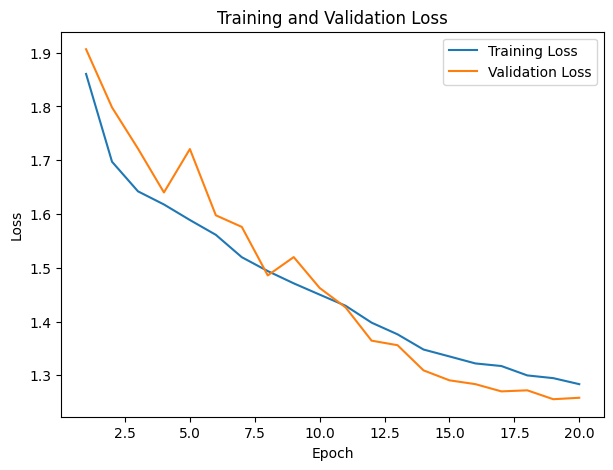

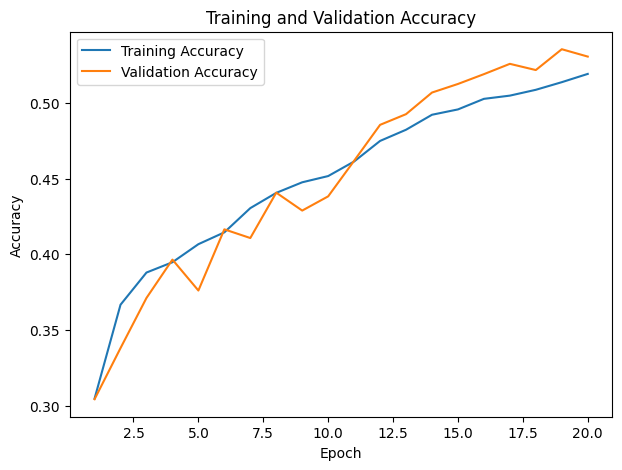

In [34]:
# Functions to plot the losses and accuracies
def plot_losses(all_train_losses, all_val_losses):
    epochs = np.arange(1, len(all_train_losses[0]) + 1)
    mean_train_loss = np.mean(all_train_losses, axis=0)
    std_train_loss = np.std(all_train_losses, axis=0)

    mean_val_loss = np.mean(all_val_losses, axis=0)
    std_val_loss = np.std(all_val_losses, axis=0)

    plt.figure(figsize=(7, 5))
    plt.plot(epochs, mean_train_loss, label='Training Loss')
    plt.plot(epochs, mean_val_loss, label='Validation Loss')
    plt.title('Training and Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

def plot_accuracies(all_train_accuracies, all_val_accuracies):
    epochs = np.arange(1, len(all_train_accuracies[0]) + 1)
    mean_train_accuracy = np.mean(all_train_accuracies, axis=0)
    std_train_accuracy = np.std(all_train_accuracies, axis=0)

    mean_val_accuracy = np.mean(all_val_accuracies, axis=0)
    std_val_accuracy = np.std(all_val_accuracies, axis=0)

    plt.figure(figsize=(7, 5))
    plt.plot(epochs, mean_train_accuracy, label='Training Accuracy')
    plt.plot(epochs, mean_val_accuracy, label='Validation Accuracy')
    plt.title('Training and Validation Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.show()

# Call the functions
plot_losses(trainer.all_train_losses, trainer.all_val_losses)
plot_accuracies(trainer.all_train_accuracies, trainer.all_val_accuracies)

# Evaluating the Model

In [41]:
# Function to evaluate the model on the test set
# Essentially re-evaluation of the averaged model on one of the folds
def evaluate_model(model, dataloader, device):
    model.to(device)
    model.eval()

    total_loss = 0.0
    all_preds = []
    all_probs = []
    all_labels = []

    loss_fn = nn.CrossEntropyLoss()

    with torch.no_grad():
        for inputs, labels, _, _ in dataloader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            loss = loss_fn(outputs, labels)
            total_loss += loss.item()

            _, preds = torch.max(outputs, 1)
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())
            probs = torch.softmax(outputs, dim=1)
            all_probs.extend(probs.cpu().numpy())

    # Calculate metrics
    avg_loss = total_loss / len(dataloader.dataset)
    accuracy = accuracy_score(all_labels, all_preds)
    precision = precision_score(all_labels, all_preds, average='macro', zero_division=0)
    recall = recall_score(all_labels, all_preds, average='macro', zero_division=0)
    f1 = f1_score(all_labels, all_preds, average='macro', zero_division=0)
    roc_auc = roc_auc_score(
        label_binarize(all_labels, classes=range(N_CLASSES)),
        np.array(all_probs),
        multi_class='ovr', average='macro'
    )
    cm = confusion_matrix(all_labels, all_preds)
    actual_vs_predicted = list(zip(all_labels[:20], all_preds[:20]))

    print(f"Test Loss: {avg_loss:.4f}")
    print(f"Test Accuracy: {accuracy:.4f}")
    print(f"Test Precision: {precision:.4f}")
    print(f"Test Recall: {recall:.4f}")
    print(f"Test F1 Score: {f1:.4f}")
    print(f"Test ROC-AUC Score: {roc_auc:.4f}")
    print(f"Confusion Matrix:\n{cm}\n")
    print(f"Actual vs. Predicted: {actual_vs_predicted}")

    return avg_loss, accuracy, precision, recall, f1, roc_auc, cm, actual_vs_predicted

In [42]:
# Instantiate and load the final model
best_model_path = trainer.best_model_path
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

best_model = SoundNet(
    nf=NF,
    clip_length=CLIP_LENGTH,
    embed_dim=EMBED_DIM,
    n_layers=N_LAYERS,
    nhead=NHEAD,
    factors=FACTORS,
    n_classes=N_CLASSES,
    dim_feedforward=DIM_FEEDFORWARD
)
best_model.load_state_dict(torch.load(best_model_path, map_location=device))

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/transformer.py:282: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because encoder_layer.self_attn.batch_first was not True(use batch_first for better inference performance)
  warnings.warn(f"enable_nested_tensor is True, but self.use_nested_tensor is False because {why_not_sparsity_fast_path}")


<All keys matched successfully>

In [43]:
# Call the function to evaluate
results = evaluate_model(best_model, test_dataloader, device)

Test Loss: 0.0754
Test Accuracy: 0.1375
Test Precision: 0.0137
Test Recall: 0.1000
Test F1 Score: 0.0242
Test ROC-AUC Score: 0.5000
Confusion Matrix:
[[  0   0   0   0   0   0   0 100   0   0]
 [  0   0   0   0   0   0   0  36   0   0]
 [  0   0   0   0   0   0   0 100   0   0]
 [  0   0   0   0   0   0   0 100   0   0]
 [  0   0   0   0   0   0   0 100   0   0]
 [  0   0   0   0   0   0   0  96   0   0]
 [  0   0   0   0   0   0   0  35   0   0]
 [  0   0   0   0   0   0   0 120   0   0]
 [  0   0   0   0   0   0   0  86   0   0]
 [  0   0   0   0   0   0   0 100   0   0]]

Actual vs. Predicted: [(2, 7), (6, 7), (0, 7), (0, 7), (7, 7), (7, 7), (4, 7), (7, 7), (5, 7), (4, 7), (3, 7), (7, 7), (7, 7), (8, 7), (7, 7), (5, 7), (4, 7), (8, 7), (9, 7), (4, 7)]
